In [135]:
import torch.nn.functional as F
import torchvision
from torchvision import transforms 
from torch.utils.data import DataLoader
import numpy as np
import torch
from torch.optim import Adam
from torch import nn
from datasets import load_dataset
from torchvision.transforms import Compose, ToTensor, Lambda, ToPILImage, CenterCrop, Resize
import matplotlib.pyplot as plt
import math
from tqdm import tqdm

import einops
from einops import rearrange

### Part 1. On attention [2 points]

Answer each question in max. 3 lines. Points will be subtracted for long answers so be short and precise. Add your explanations in the below box - NO added handwritten images, write in latex!

1. [0.5 point] You are given an input $X=[x_1,...,x_L]$ (e.g. a sentence of tokenised words). Your goal is to predict the next token $x_i$ conditional on $x_{1},...,x_{i}$. In other words, the $i$-th position can only be influenced by a position $j$ if and only if $j \leq i$, namely a position cannot be influenced by the subsequent positions.
    a. What would be the problem when passing $X$ through attention? Explain using the computations that attention performs, e.g. you can write out the matrix multiplication. 
    b. How could you ensure that the prediction for position $i$ depends solely on positions $j\leq i$? Hint: what in the attention computation should be masked & in what way? 
2. [0.5 point] Let's consider multi-head attention. How does multi-head attention change the computations inside the softmax (the $QK^T$ term) and the product with $V$ and why could this be beneficial to learning? 
3. [0.5 point] Remember that standard attention is given by 
\begin{align}
Q = XW^Q, \; K=XW^K, \; V=XW^V, \;\; \textnormal{with} A(X) = softmax\left(\frac{QK^T}{\sqrt{D}}\right)V
\end{align}
for a sequence $X\in\mathbb{R}^{L\times D}$ with $L$ the sequence length. 
What is the memory and computational cost of attention in terms of the sequence length and where does this come from? 
4. [0.5 point] A big focus these days is on making attention more computationally efficient. The $i$-th row (as a vector) of attention can be rewritten as, 
\begin{align}
A(X)_i = \frac{\sum_{j=1}^L sim(Q_i,K_j)V_j}{\sum_{j=1}^L sim(Q_i,K_j)},
\end{align}
with $sim(q,k)=exp(q^Tk/\sqrt{D})$.
Linear attention would be given by, 
\begin{align}
A(X)_i = \frac{\sum_{j=1}^L \phi(Q_i)^T\phi(K_j)V_j}{\sum_{j=1}^L\phi(Q_i)^T\phi(K_j)}. 
\end{align} 
Explain the relation between regular attentin and linear attention (i.e. what kind of similarity function does linear attention assume and how is the approximation made?) & how the above expression can be rewritten and use this to explain why linear attention computation can be done more efficiently compared to standard attention. 

Fill in your answers below. 

1. \
a. When passing X through attention to predict some $x_i$, $A(X) = softmax\left(\frac{QK^T}{\sqrt{D}}\right)V$, our prediction is inherently influenced by all tokens. The output, $a_{ij} = \frac{e^{s_{ij}}}{\sum_{l=1}^{L} e^{s_{il}}}$ where $s_{ij} = \frac{(W^Qx_i) \cdot (W^Kx_j)^T}{\sqrt{d_k}}$, includes $x_j$ where $i < j$, which violates the dependence condition.\
b. To satisfy the requirements we must remove dependence on positions j > i. We can mask these positions by initialising a mask matrix M such that $M_{ij} = 0$ for j $\leq$ i and $-\infty$ for j > i, the masked scores are then: $s_{ij}^{masked} = s_{ij} + M_{ij}$, such that after softmax the prediction vector is 0 for all j > i ($softmax(-\infty)$=0), thus preventing influence from these positions.

2. MHA splits Q, K and V into h smaller 'heads', each computing a seperate attention with their corresponding $Q^iK^{iT}$'s scaled by $ \frac{1}{\sqrt{d_{k_i}}}$, where $d_{k_i}$ is the length of the head, followed by softmax and multiplication with $V^i$; the h attentions are concatenated and linearly transformed allowing each head to focus on a different data aspect, yielding a richer feature set without scaling computational complexity with input length like attention.

3. Memory cost of storing Q, K and V is proportional to 3LD, cost of attention scores $QK^T$ is $O(L^2)$, which is the main contributer in terms of length. Computational cost of $QK^T$ is $O(L^2D)$, softmax of $QK^T$ and multiplication by V is $O(L^2)$, hence quadratic complexity in L for both memory and computation.

4. Linear attention computes the relationship between $Q$ and $K$ by transforming into a space the similarities can be computed linearly, with $\phi(Q_i)^T\phi(K_j)$. This is more computationally efficient than regular attention due to rewriting $A(X)_i = \frac{\phi(Q_i)^T \sum_{j=1}^L \phi(K_j)V_j}{\phi(Q_i)^T \sum_{j=1}^L\phi(K_j)}$, allowing us to precompute $\sum_{j=1}^L\phi(K_j)$ and $\sum_{j=1}^L \phi(K_j)V_j$ and apply to each query with $O(L)$ as opposed to the previous computation of $Q^TK$ of $O(L^2)$.

### Part 2. On diffusion models [12 points]

We will be implementing a diffusion model. We will follow mostly the setup as done here: https://arxiv.org/pdf/2006.11239.pdf so please refer to this work for more details if needed. 

Your goal will be to implement the code for the diffusion model, find the right configuration to train the model, achieve good accuracy and efficiency and finally interpret how the model learns. You will be marked on clean code, concise answers and good results. 

We will be working with the FashionMNIST dataset. You can load the data using the below code. 

In [75]:
#activate GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [136]:
#activate GPU if using M1 chip
device = 'mps'

In [137]:
IMG_SIZE = 28
BATCH_SIZE = 128

# load dataset from the hub
dataset = load_dataset("fashion_mnist")
channels = 1

# define image transformations (e.g. using torchvision)
transform = Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),
            transforms.Lambda(lambda t: (t * 2) - 1)
])

# define function
def transforms(examples):
    examples["pixel_values"] = [transform(image.convert("L")) for image in examples["image"]]
    del examples["image"]
    return examples

transformed_dataset = dataset.with_transform(transforms).remove_columns("label")

dataloader = DataLoader(transformed_dataset['train'], batch_size=BATCH_SIZE, shuffle=True, drop_last=True)
# test dataloader to ensure the model is not learning the training data
test_dataloader = DataLoader(transformed_dataset['test'], batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

The following helper functions will be useful. In particular, whenever we input a vector (list) of values, this will help to select the right time t output. We will use this in the sampling loops. 

In [138]:
def get_index_from_list(vals, t, x_shape):
    """ 
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

##### 1. The noising process [2 points]

[1.5 pts] Our first step will be to implement the forward process that adds noise to an image. 

We will be adding noise according to a linear schedule, i.e. the noises $\beta_t$, $t=1,...,T$ will come from an equally spaced vector. Implement the `linear_beta_schedule` function. Remember $\alpha_t = 1-\beta_t$ and $\bar \alpha_t = \prod_{s=1}^t \alpha_s$. 

Remember that we have the closed-form solutions for the image at time $t$. Use those in the implementation of `forward_diffusion_sample` instead of a for loop over each noising step. This means you will need to implement `sqrt_one_minus_alphas_cumprod` which represents $\sqrt{1-\bar\alpha_t}$ and `sqrt_alphas_cumprod` which represents $\sqrt{\bar\alpha_t}$. 

Test the function on an image from the dataset using the given code below. 

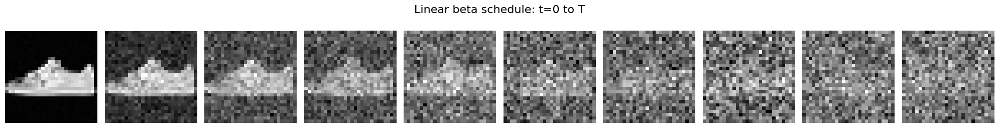

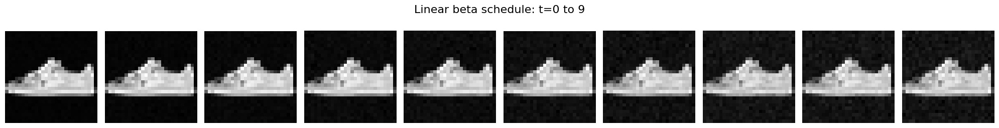

In [139]:
def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    '''
    output a vector of size timesteps that is equally spaced between start and end; this will be the noise that is added in each time step. 
    '''
    betas = torch.linspace(start, end, timesteps)
    return betas

def cosine_beta_schedule(timesteps, start=0.0001, end=0.02):
    '''
    output a vector of size timesteps that follows a cosine schedule between start and end; this will be the noise that is added in each time step. 
    '''
    # Create a tensor of equally spaced values between -pi/2 and pi/2
    t = torch.linspace(-math.pi, 0, timesteps)
    
    # Apply the cosine function to the tensor, then scale and shift the values to the range [start, end]
    betas = (torch.cos(t) + 1) / 2 * (end - start) + start
    
    return betas

def exponential_beta_schedule(timesteps, start=0.0001, end=0.02):
    '''
    output a vector of size timesteps that follows an exponential schedule between start and end; this will be the noise that is added in each time step. 
    '''
    # Create a tensor of equally spaced values between 0 and 1
    t = torch.linspace(0, 1, timesteps)
    
    # Apply the exponential function to the tensor, then scale and shift the values to the range [start, end]
    betas = (torch.exp(t) - 1) / (math.e - 1) * (end - start) + start
    
    return betas

def sigmoid_beta_schedule(timesteps, start=-1.0, end=1.0):
    # Create a tensor of equally spaced values in the range suitable for sigmoid
    t = torch.linspace(start, end, timesteps)
    
    # Apply the sigmoid function to the tensor
    betas = torch.sigmoid(t)
    
    # Scale and shift the values to the range [start, end]
    betas = betas * (end - start) + start
    
    return betas

def forward_diffusion_sample(x_0, t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod, device="cpu"):
    """ 
    Takes an image and a timestep as input and 
    returns the noisy version of it
    Hint: use the get_index_from_list function to select the right values at time t. 
    """
    #print(f'x shape: {x_0.shape}')
    # Extract the correct value from sqrt_alphas_cumprod and sqrt_one_minus_alphas_cumprod arrays
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod,t,x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod,t,x_0.shape)
    # Calculate the mean and std to sample from the normal distribution
    noise = torch.randn_like(x_0)
    x_t = sqrt_alphas_cumprod_t.to(device) * x_0 + sqrt_one_minus_alphas_cumprod_t.to(device) * noise

    return x_t, noise

# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)
#betas = cosine_beta_schedule(timesteps=T)
#betas = exponential_beta_schedule(timesteps=T)
#betas = softmax_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
# ADD HERE THE COMPUTATIONS NEEDED for sqrt_alphas_cumprod and sqrt_one_minus_alphas_cumprod
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, dim=0)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_recip_alphas = torch.sqrt(1.0/alphas)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
#posterior_variance = betas*(1. - F.pad(alphas_cumprod[:-1],(1,0),value=1.0))/(1. - alphas_cumprod)

# Simulate forward diffusion
batch = next(iter(dataloader))["pixel_values"]

plt.figure(figsize=(20, 3))  # Adjust the figure size as necessary for a horizontal layout

# Plot a random sample every ten timesteps to visulise the forward process
num_images = 10
stepsize = int(T / num_images)

for i in range(num_images):
    idx = i * stepsize
    t = torch.Tensor([idx]).type(torch.int64)
    img, noise = forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod)

    # Setup subplot for a 1x10 grid. Note the change here to (1, 10, i + 1)
    plt.subplot(1, 10, i + 1)
    plt.imshow(img.reshape(28, 28), cmap="gray")
    plt.axis('off')  # Hide the axis for a cleaner look
plt.tight_layout()  # Adjust layout to minimize overlap
plt.suptitle("Linear beta schedule: t=0 to T", fontsize=16)
plt.show()

plt.figure(figsize=(20, 3))
stepsize = 1
for i in range(num_images):
    idx = i * stepsize
    t = torch.Tensor([idx]).type(torch.int64)
    img, noise = forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod)

    # Setup subplot for a 1x10 grid. Note the change here to (1, 10, i + 1)
    plt.subplot(1, 10, i + 1)
    plt.imshow(img.reshape(28, 28), cmap="gray")
    plt.axis('off')  # Hide the axis for a cleaner look


plt.tight_layout()  # Adjust layout to minimize overlap
plt.suptitle("Linear beta schedule: t=0 to 9", fontsize=16)
plt.show()


[0.5 pt] Play around with the noise (compare two different beta schedules), present results for the two settings and discuss (in max. 3 lines) how the hyperparameters change the forward sampling. 

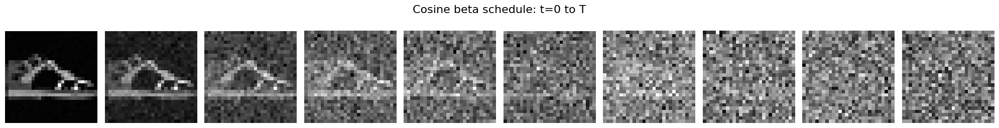

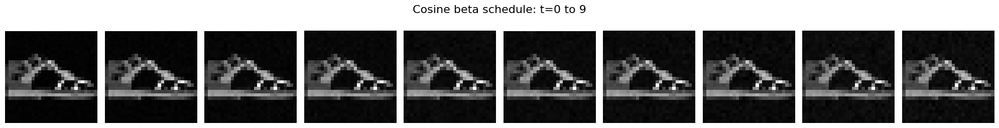

In [ ]:
# Define beta schedule
T = 300
#betas = linear_beta_schedule(timesteps=T)
betas = cosine_beta_schedule(timesteps=T)
#betas = exponential_beta_schedule(timesteps=T)
#betas = sigmoid_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
# ADD HERE THE COMPUTATIONS NEEDED for sqrt_alphas_cumprod and sqrt_one_minus_alphas_cumprod
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, dim=0)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_recip_alphas = torch.sqrt(1.0/alphas)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
#posterior_variance = betas*(1. - F.pad(alphas_cumprod[:-1],(1,0),value=1.0))/(1. - alphas_cumprod)

# Simulate forward diffusion
batch = next(iter(dataloader))["pixel_values"]

plt.figure(figsize=(20, 3))  # Adjust the figure size as necessary for a horizontal layout

# Plot a random sample every ten timesteps to visulise the forward process
num_images = 10
stepsize = int(T / num_images)

for i in range(num_images):
    idx = i * stepsize
    t = torch.Tensor([idx]).type(torch.int64)
    img, noise = forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod)

    # Setup subplot for a 1x10 grid. Note the change here to (1, 10, i + 1)
    plt.subplot(1, 10, i + 1)
    plt.imshow(img.reshape(28, 28), cmap="gray")
    plt.axis('off')  # Hide the axis for a cleaner look
plt.tight_layout()  # Adjust layout to minimize overlap
plt.suptitle("Cosine beta schedule: t=0 to T", fontsize=16)
plt.show()

plt.figure(figsize=(20, 3))
stepsize = 1
for i in range(num_images):
    idx = i * stepsize
    t = torch.Tensor([idx]).type(torch.int64)
    img, noise = forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod)

    # Setup subplot for a 1x10 grid. Note the change here to (1, 10, i + 1)
    plt.subplot(1, 10, i + 1)
    plt.imshow(img.reshape(28, 28), cmap="gray")
    plt.axis('off')  # Hide the axis for a cleaner look

plt.tight_layout()  # Adjust layout to minimize overlap
plt.suptitle("Cosine beta schedule: t=0 to 9", fontsize=16)
plt.show()

# Linear beta schedule vs Cosine beta Schedule

A beta scedule for a diffusion model should add noise to a clear image for T timesteps until the signal is destroyed, I have presented a linear schedule which increases the noise added at each timestep linearly, and a $-\pi$ to $\pi$ cosine schedule to have less noise added at the start and end of the process to ensure a more controlled noise prediction.

##### 2. The model for the noise [4 points]

We use a simple form of a UNet to predict the noise in the image. The input into the neural network will be a noisy image and the ouput from the model will be the noise in the image. It is important to also pass in the timestep into the neural network (so the model knows at which time we want to denoise the image) and we do this by passing it through a sinusoidal position embedding. 

[0.5pt] Write code for the Sinusoidal Position Embedding. This should output a matrix $PE$ of size `[timesteps, dimension]` with elements:

\begin{align}
&PE_{pos,2i} = \sin\left(\frac{pos}{10000^{2i/dim}}\right),\\
&PE_{pos,2i+1} = \cos\left(\frac{pos}{10000^{2i/dim}}\right),
\end{align}
where `pos` refers to the time position and `i` refers to the dimension position and `dim` the total dimension we are working with. 

Use however the following identity to implement: 
\begin{align}
\frac{pos}{10000^{2i/dim}} = \exp\left(\log(pos) - \frac{2i}{dim}\log(10000)\right).
\end{align}

In [140]:
class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        positions = torch.arange(time.shape[0], device=device).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, self.dim, 2, device=device) * -(torch.log(torch.tensor(10000.0, device=device)) / self.dim))
        pe = torch.zeros(time.shape[0], self.dim, device=device)
        pe[:, 0::2] = torch.sin(positions * div_term)
        pe[:, 1::2] = torch.cos(positions * div_term)
        return pe

[0.5pt] Visualise the positional embeddings with arbitary time and dimension and discuss what position embeddings do (why do we add them, why this particular embedding structure) in max. 3 lines. 

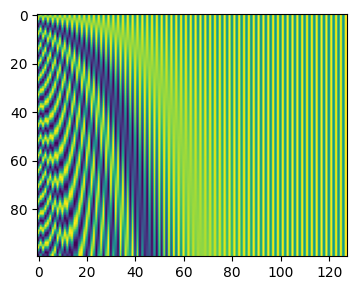

In [142]:
# Write here the code to visualise the positional embedding
spe = SinusoidalPositionEmbeddings(128)
plt.figure(figsize=(4,4))
plt.imshow(spe(torch.arange(1,101,1)).to("cpu"))

Positional embeddings equip the model with an understanding of sequences/positions in time, in our case our model needs to discern the timestep of the input image enabling more accurate noise predictions. We choose sinusoidal as it encodes both position and relative position in time, and its periodic nature allows the model to interpolate, extrapolate and generalise across timesteps.

Below is the code for a Block, that will make up the final UNet. 

[0.5pt] Fill in the missing parts. 

Remember that in the UNet architecture, we have a downsampling phase and an upsampling phase. Depending on which phase we are in, we need to make use of the up or down-sample operations. 

[0.5pt] Add here an explanation as to what the block does including the up and downsample operations in maximum 3 lines:

Explanation of a Block: The block injects temporal information between two convolution, batchnorm and activation sequences, enriching the feature maps ability to caputure time dependent patterns, followed by an encoding/decoding transformation responsible for reducing/increasing the spatial dimension and increasing/decreasing the feature representation depth (channels) for down/up respectively.

In [154]:
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False, pool=False):
        '''
        in_ch refers to the number of channels in the input to the operation and out_ch how many should be in the output
        '''
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        elif pool:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            # Here I step down with a maxpooling operation, which does not require any parameters and follows the UNET architecture.
            self.transform = nn.MaxPool2d(2,stride=2) 
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4,2,1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

        
    def forward(self, x, t):
        '''
        Define the forward pass making use of the components above. 
        Time t should get mapped through the time_mlp layer + a relu
        The input x should get mapped through a convolutional layer with relu / batchnorm
        The time embedding should get added the output from the input convolution 
        A second convolution should be applied and finally passed through the self.transform. 
        '''
        time_emb = self.time_mlp(t)
        time_emb = self.relu(time_emb)
        
        x = self.conv1(x)
        x = self.bnorm1(x)
        x = self.relu(x)
        
        x = x + time_emb.unsqueeze(-1).unsqueeze(-1)
        x = self.conv2(x)
        x = self.bnorm2(x)
        x = self.relu(x)
        
        x = self.transform(x)
        return x

[1.5pt] Use the above code to fill in the code for the UNet below. 

In [153]:
class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 1
        down_channels = (32, 64, 128) # These are the channels that we want to obtain in the downsampling stage; These are hyperparameters and these numbers give a short architecture with enough capacity.
        up_channels = (128,64,32) # These are the channels that we want to obtain in the upsampling stage; Defined by down_channels but reversed, and halved when there is no residual connection
        out_dim = 1 # output channels
        time_emb_dim = 32 # a hyperparameter, 32 captures the time information well in this case.

        # Time embedding consists of a Sinusoidal embedding, a linear map that maintains the dimensions and a rectified linear unit activation. 
        # TO WRITE CODE
        self.time_emb = nn.Sequential(SinusoidalPositionEmbeddings(time_emb_dim),
                                nn.Linear(time_emb_dim, time_emb_dim),
                                nn.ReLU())
        
        # Initial projection consisting of a map from image_channels to down_channels[0] with a filter size of e.g. 3 and padding of 1. 
        # TO WRITE CODE
        self.init_proj = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)
        # Downsample: use the Blocks given above to define down_channels number of downsampling operations. These operations should cha
        # TO WRITE CODE HERE; HINT: use something like Block(down_channels[i], down_channels[i+1], time_emb_dim) the right number of times. 
        self.down = nn.ModuleList([Block(down_channels[i], down_channels[i+1], time_emb_dim) for i in range(len(down_channels)-1)])
        # Upsample
        # TO WRITE CODE HERE; same logic as the downsample
        self.up = nn.ModuleList([Block(up_channels[i], up_channels[i+1], time_emb_dim, up=True) for i in range(len(up_channels)-1)])
        # Final output: given by a final convolution that maps up_channels[-1] to out_dim with a kernel of size 1. 
        # TO WRITE CODE
        self.final = nn.Conv2d(up_channels[-1], out_dim, 1) # In this architecture we concatenate the output from the last upsample stage with the output from the first downsample stage.

    def forward(self, x, timestep):
        # Embedd time
        time_emb = self.time_emb(timestep)
        # Initial convolution
        x = self.init_proj(x)
        # Unet: iterate through the downsampling operations and the upsampling operations. Do not forget to include the residual connections 
        # between the outputs from the downsample stage and the upsample stage. 

        # Empty list to store the skip connections
        skip_connections = []
        # Encode: In this UNET architecture the
        for block in self.down:
            # Save the current state before encoding
            x = block(x, time_emb)
            skip_connections.append(x)
            
            
        # Decode
        for block, skip_connection in zip(self.up, skip_connections[::-1]):
            # Concatenate the residual connection when there is a skip connection
            x = torch.cat((x, skip_connection), dim=1)
            x = block(x, time_emb)
        # Final convolution
        x = self.final(x)
        return x

[0.5pt] Finally, define a loss function. Note that this loss function should take x_0 and t to sample the forward diffusion model, get a noisy image, use this noisy image in the model to get the noise added and finally compare true added noise and model outputs added noise. 

In [156]:
def get_loss(model, x_0, t):
    '''
    Define the right loss given the model, the true x_0 and the time t
    '''
    # Extract the noisy version of the image and the target noise
    x_t, noise = forward_diffusion_sample(x_0, t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod, device=device)
    # Pass the noisy image through the model
    out_noise = model(x_t, t)
    # Calculate the loss
    loss = F.l1_loss(out_noise, noise)
    return loss

##### Part 3: The sampling [1 point]

Write a piece of code that can be used to predict the noise and return the denoised image. This function should work on a single image and make sure that the function can be used in the `sample` function properly. Note that we will need the `posterior_variance` denoted by $\sigma$ in the paper and the `sqrt_recip_alphas` given by $1/\alpha_t$. Make sure to set the right choice of $\sigma$ (see the paper). 

In [157]:
# compute posterior_variance 
sqrt_recip_alphas = torch.sqrt(1.0/alphas)
posterior_variance = betas*(1. - F.pad(alphas_cumprod[:-1],(1,0),value=1.0))/(1. - alphas_cumprod)
print(posterior_variance.shape)
#posterior_variance = betas

@torch.no_grad()
def sample_timestep(x, t, i, posterior_variance, sqrt_one_minus_alphas_cumprod, sqrt_recip_alphas, model):
    """
    Calls the model to predict the noise in the image and returns 
    the denoised image. 
    Applies noise to this image, if we are not in the last step yet.
    Note that it also needs additional arguments about the posterior_variance, sqrt_minus_alphas_cumprod and sqrt_recip_alphas. 
    """
    # Call model to predict the noise
    noise = model(x, t)
    
    # Extract the correct values from the lists
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x.shape)
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)
    beta_t = get_index_from_list(betas, t, x.shape)
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)
    # Use closed form solution to calculate the mean of the posterior
    x_mean = sqrt_recip_alphas_t*(x - beta_t*noise/sqrt_one_minus_alphas_cumprod_t)
    # If we are not in the last step, add noise to the mean, otherwise return the mean
    if i == 0:
        return x_mean
    else:
        x = x_mean + torch.sqrt(posterior_variance_t)*torch.randn_like(x)
        return x

@torch.no_grad()
def sample(model, shape):
    device = next(model.parameters()).device
    # The model should be sampled in eval mode to prevent dropout layers from changing their behaviour and giving random results
    model.eval()
    b = shape[0]
    # start from pure noise (for each example in the batch)
    img = torch.randn(shape, device=device)
    imgs = []
    # Loop from time T to 0 calling the sample_timestep function
    for i in tqdm(reversed(range(0, T)), desc='sampling loop time step', total=T):
        t = torch.full((b,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t, i, posterior_variance, sqrt_one_minus_alphas_cumprod, sqrt_recip_alphas, model)
        imgs.append(img.cpu().numpy())
    # Return to training mode in case of sampling during training
    model.train()
    return imgs

torch.Size([300])


##### Part 4. Write the training loop and present & interpret your results [6 points]

Code a training loop that instantiates the model, defines an optimiser, defines a number of epochs, iterates over the epochs and the datapoints inside the epoch and for each iteration samples a timestep, uses this timestep to loss function and update parameters based on this. 

Note: this is the part requiring most computational resources. You may need to train the model for quite a few epochs to get good results. Be sure to start on time to ensure enough access to GPUs on Google Colab. 

0.5 point will be given for correct implementation. 

1.5 points will be given according to how many **sensible** samples (with max points given for 10 good samples; scaled accordingly for less samples) you manage to obtain (i.e. the performance of your model in generating good datapoints). 

2 points will be given according to how efficient you can make the train process to still produce at least 10 good samples. You are free to change anything in the architecture! Your output will be compared to my base setup which uses `50` epochs and has a model with `Num params:  929409`. 1 point will be assigned scaled according to how much less epochs you can use and 1 points scaled with how much less params you manage to use. Be sure to print your number of parameters, training epochs and the 10 sensible images. 

2 points will be given for the interpretation of your results that allows us to better understand *how* the model learns. For this you are asked to visualise the generated samples during the training process. Can you identify any properties of *how* the model learns? Are there particular aspects the model starts paying attention to / is able to generate before others? 

# Training loop (unoptimised)

The model has 929409 parameters


100%|██████████| 468/468 [00:38<00:00, 12.07it/s]


Epoch 1 loss: 0.2565112070013315
Test loss: 0.2088897875868357


sampling loop time step: 100%|██████████| 300/300 [00:03<00:00, 86.50it/s] 


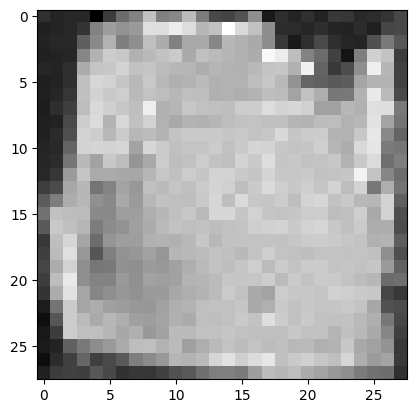

100%|██████████| 468/468 [00:34<00:00, 13.57it/s]


Epoch 2 loss: 0.1980816046269531
Test loss: 0.19443719910505491


100%|██████████| 468/468 [00:32<00:00, 14.28it/s]


Epoch 3 loss: 0.1883799271005341
Test loss: 0.18776113291581473


100%|██████████| 468/468 [00:33<00:00, 14.08it/s]


Epoch 4 loss: 0.1827899701256528
Test loss: 0.18094054800577652


100%|██████████| 468/468 [00:33<00:00, 14.18it/s]


Epoch 5 loss: 0.17911703964201814
Test loss: 0.17731566383288458


100%|██████████| 468/468 [00:31<00:00, 15.07it/s]


Epoch 6 loss: 0.1771229644998526
Test loss: 0.17814262879964632


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 131.55it/s]


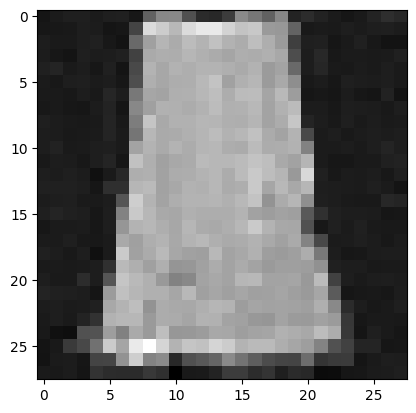

100%|██████████| 468/468 [00:31<00:00, 14.89it/s]


Epoch 7 loss: 0.1749241211029709
Test loss: 0.17488868209796074


100%|██████████| 468/468 [00:31<00:00, 14.89it/s]


Epoch 8 loss: 0.17377080876603085
Test loss: 0.1720655545210227


100%|██████████| 468/468 [00:32<00:00, 14.51it/s]


Epoch 9 loss: 0.17092084088641354
Test loss: 0.17117833900145996


100%|██████████| 468/468 [00:31<00:00, 14.81it/s]


Epoch 10 loss: 0.16940549499968177
Test loss: 0.16997134876556885


100%|██████████| 468/468 [00:31<00:00, 14.65it/s]


Epoch 11 loss: 0.1687402819784788
Test loss: 0.16830423034918615


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 131.26it/s]


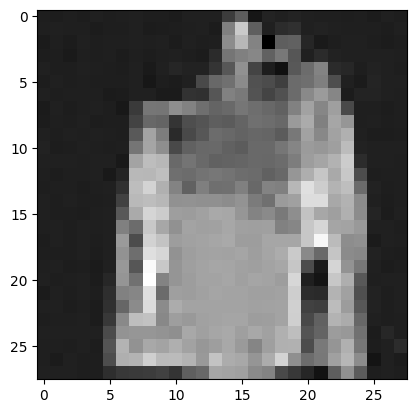

100%|██████████| 468/468 [00:32<00:00, 14.61it/s]


Epoch 12 loss: 0.1663680619154221
Test loss: 0.16634962554925528


100%|██████████| 468/468 [00:32<00:00, 14.54it/s]


Epoch 13 loss: 0.16576646943377632
Test loss: 0.16662534593771666


100%|██████████| 468/468 [00:32<00:00, 14.60it/s]


Epoch 14 loss: 0.16490474215939513
Test loss: 0.16497611560118505


100%|██████████| 468/468 [00:31<00:00, 14.63it/s]


Epoch 15 loss: 0.16480572005877128
Test loss: 0.1652683546909919


100%|██████████| 468/468 [00:31<00:00, 14.77it/s]


Epoch 16 loss: 0.16404336353397778
Test loss: 0.16484485604824164


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 130.38it/s]


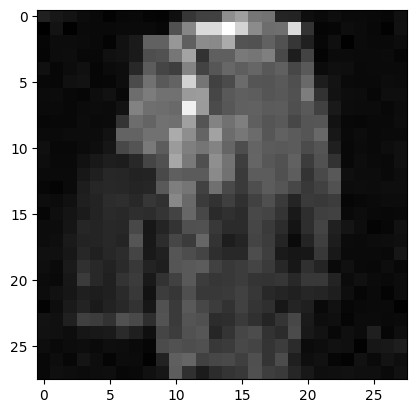

100%|██████████| 468/468 [00:32<00:00, 14.56it/s]


Epoch 17 loss: 0.16293364123274118
Test loss: 0.1638971276772328


100%|██████████| 468/468 [00:31<00:00, 14.65it/s]


Epoch 18 loss: 0.16247275586311632
Test loss: 0.16140358704022872


100%|██████████| 468/468 [00:32<00:00, 14.52it/s]


Epoch 19 loss: 0.16132741166740402
Test loss: 0.16184996011165473


100%|██████████| 468/468 [00:32<00:00, 14.43it/s]


Epoch 20 loss: 0.1611532434566408
Test loss: 0.1624125123788149


100%|██████████| 468/468 [00:32<00:00, 14.52it/s]


Epoch 21 loss: 0.16077178063937742
Test loss: 0.1612785326746794


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 132.74it/s]


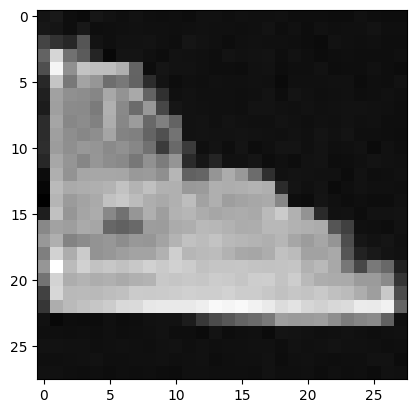

100%|██████████| 468/468 [00:32<00:00, 14.32it/s]


Epoch 22 loss: 0.1602769219276742
Test loss: 0.16179558539237732


100%|██████████| 468/468 [00:30<00:00, 15.12it/s]


Epoch 23 loss: 0.15940522701821774
Test loss: 0.15770755402552775


100%|██████████| 468/468 [00:33<00:00, 14.18it/s]


Epoch 24 loss: 0.15899668105392376
Test loss: 0.15984756098343775


100%|██████████| 468/468 [00:33<00:00, 14.12it/s]


Epoch 25 loss: 0.15842119744445524
Test loss: 0.15984800457954407


100%|██████████| 468/468 [00:33<00:00, 13.92it/s]


Epoch 26 loss: 0.15785534237312454
Test loss: 0.15879478477514708


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 111.43it/s]


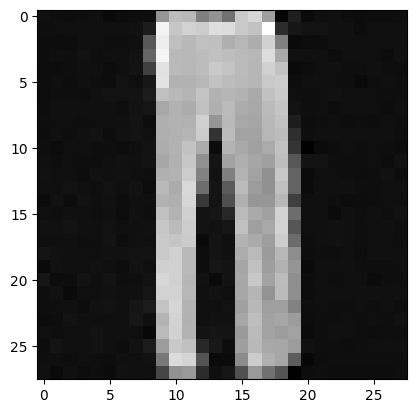

100%|██████████| 468/468 [00:31<00:00, 14.63it/s]


Epoch 27 loss: 0.15772288330854514
Test loss: 0.15865312535793352


100%|██████████| 468/468 [00:31<00:00, 15.10it/s]


Epoch 28 loss: 0.15770561576016948
Test loss: 0.15938232839107513


100%|██████████| 468/468 [00:31<00:00, 14.75it/s]


Epoch 29 loss: 0.1577466620912409
Test loss: 0.1558589599071405


100%|██████████| 468/468 [00:32<00:00, 14.54it/s]


Epoch 30 loss: 0.15672874132282713
Test loss: 0.15659209512747252


100%|██████████| 468/468 [00:31<00:00, 14.88it/s]


Epoch 31 loss: 0.15605299123841473
Test loss: 0.1581324841349553


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 128.77it/s]


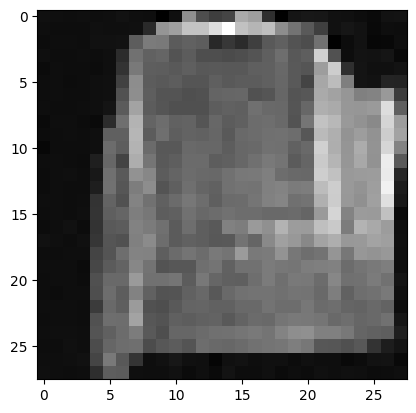

100%|██████████| 468/468 [00:31<00:00, 15.01it/s]


Epoch 32 loss: 0.1562697056712758
Test loss: 0.15683715886030442


100%|██████████| 468/468 [00:30<00:00, 15.24it/s]


Epoch 33 loss: 0.1562097708766277
Test loss: 0.1549924088594241


100%|██████████| 468/468 [00:30<00:00, 15.23it/s]


Epoch 34 loss: 0.15537303011132103
Test loss: 0.1569215850188182


100%|██████████| 468/468 [00:30<00:00, 15.25it/s]


Epoch 35 loss: 0.1559352998295401
Test loss: 0.15484694162240395


100%|██████████| 468/468 [00:31<00:00, 14.85it/s]


Epoch 36 loss: 0.1552208726350059
Test loss: 0.15702287012185806


sampling loop time step: 100%|██████████| 300/300 [00:03<00:00, 87.91it/s] 


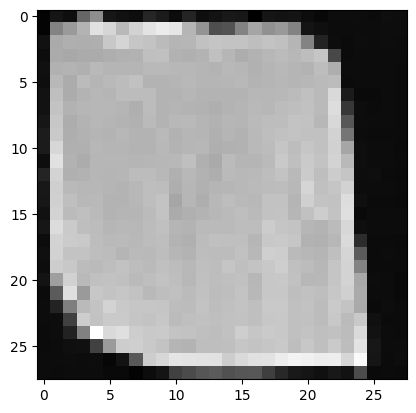

100%|██████████| 468/468 [00:32<00:00, 14.21it/s]


Epoch 37 loss: 0.15482411867915055
Test loss: 0.15350350794883874


100%|██████████| 468/468 [00:31<00:00, 14.63it/s]


Epoch 38 loss: 0.15534652346092412
Test loss: 0.15648075842704529


100%|██████████| 468/468 [00:32<00:00, 14.32it/s]


Epoch 39 loss: 0.15476402525718397
Test loss: 0.15502831626396912


100%|██████████| 468/468 [00:31<00:00, 14.94it/s]


Epoch 40 loss: 0.1537376328283905
Test loss: 0.15456831703583399


100%|██████████| 468/468 [00:31<00:00, 14.81it/s]


Epoch 41 loss: 0.15389904567701185
Test loss: 0.15646295631543183


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 130.81it/s]


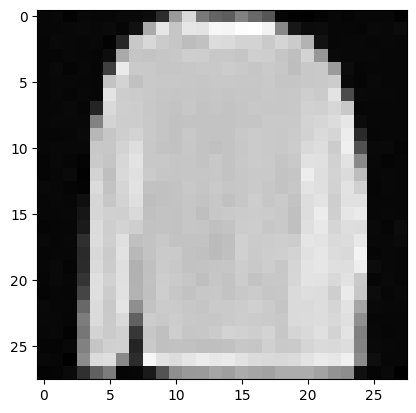

100%|██████████| 468/468 [00:33<00:00, 13.90it/s]


Epoch 42 loss: 0.15447405235380188
Test loss: 0.15375934254664642


100%|██████████| 468/468 [00:31<00:00, 14.74it/s]


Epoch 43 loss: 0.15376467330970317
Test loss: 0.15223740136776215


100%|██████████| 468/468 [00:31<00:00, 14.79it/s]


Epoch 44 loss: 0.15380174510626712
Test loss: 0.1542872028091015


100%|██████████| 468/468 [00:31<00:00, 14.96it/s]


Epoch 45 loss: 0.15364071019949058
Test loss: 0.15309986414817664


100%|██████████| 468/468 [00:35<00:00, 13.13it/s]


Epoch 46 loss: 0.15324215390361273
Test loss: 0.1539502013952304


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 115.40it/s]


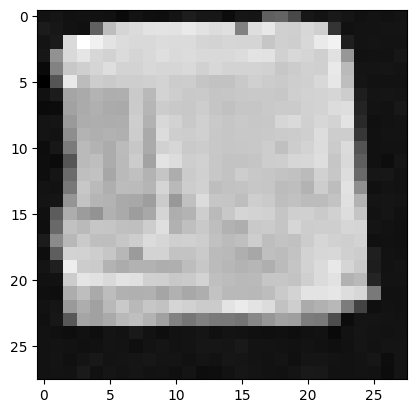

100%|██████████| 468/468 [00:34<00:00, 13.63it/s]


Epoch 47 loss: 0.15300943842555723
Test loss: 0.15290823922707483


100%|██████████| 468/468 [00:34<00:00, 13.61it/s]


Epoch 48 loss: 0.15316599820796242
Test loss: 0.15312860619563323


100%|██████████| 468/468 [00:30<00:00, 15.17it/s]


Epoch 49 loss: 0.1526033418555545
Test loss: 0.15348568635109144


100%|██████████| 468/468 [00:30<00:00, 15.11it/s]


Epoch 50 loss: 0.1531514148745272
Test loss: 0.15522678272846419


In [158]:
# Code for the training loop goes here
# Define the model, put on device and set to training mode
model = SimpleUnet()
model = model.to(device)
model.train()
#print number of parameters
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f'The model has {count_parameters(model)} parameters')
# Define the optimizer
optimizer = Adam(model.parameters(), lr=0.001)

# Training loop
for epoch in range(50):
    epoch_loss = 0
    # Loop over the dataset
    for batch in tqdm(dataloader):
        # Zero the gradients
        optimizer.zero_grad()
        # Put data on device
        x_0 = batch["pixel_values"].to(device)
        # Randomise the time step so that the model sees a diverse set of time steps
        t = torch.randint(0, T, (BATCH_SIZE,), device=device)
        # Calculate the loss, backpropagate and update the weights
        loss = get_loss(model, x_0, t)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        #print(f"Batch loss: {loss.item()}")
        
    print(f"Epoch {epoch+1} loss: {epoch_loss/len(dataloader)}")
    
    # The test loss should be similar to the train loss if the model is not overfitting
    test_loss = 0
    for batch in test_dataloader:
        x_0 = batch["pixel_values"].to(device)
        t = torch.randint(0, T, (BATCH_SIZE,), device=device)
        loss = get_loss(model, x_0, t)
        test_loss += loss.item()
    print(f"Test loss: {test_loss/len(test_dataloader)}")

    # Visualize the results
    if epoch % 5 == 0:
        imgs = sample(model, (1, 1, 28, 28))
        plt.imshow(imgs[-1][0].squeeze(), cmap="gray")
        plt.show()



Finally, after training is done, use the `sample` to sample new images. 

# Unoptimised UNET samples

sampling loop time step: 100%|██████████| 300/300 [00:03<00:00, 84.26it/s] 


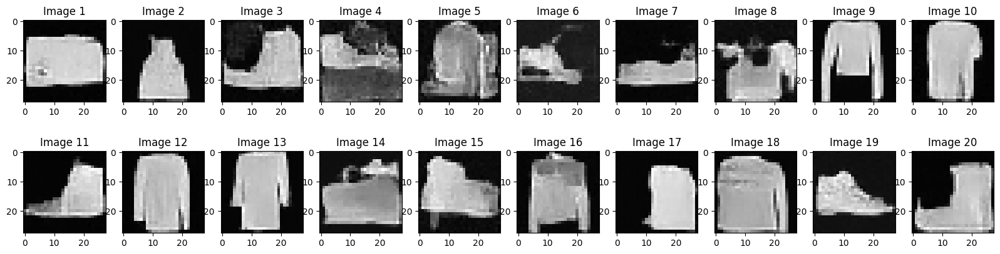

In [172]:
#random samples
torch.manual_seed(31)
model.eval()
# Sample from the model
imgs = sample(model, (20, 1, 28, 28))
fig, axs = plt.subplots(2, 10, figsize=(20, 5))
for i in range(20):
    row = i // 10
    col = i % 10
    axs[row, col].imshow(imgs[-1][i][0].squeeze(), cmap="gray")
    axs[row, col].set_title(f"Image {i+1}")

plt.show()


# 10 good samples

sampling loop time step: 100%|██████████| 300/300 [00:08<00:00, 34.75it/s]


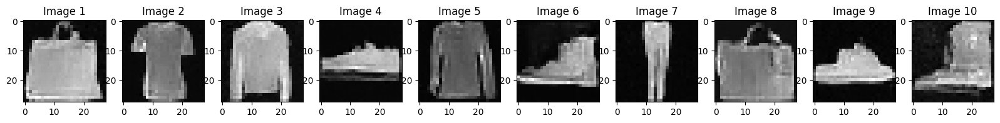

In [170]:
# Code for the plotting of samples goes here
model.eval()
torch.manual_seed(91)
imgs = sample(model, (200, 1, 28, 28))
fig, axs = plt.subplots(1, 10, figsize=(20, 10))
idx = [141,18,9,111,63,36,99,197,20,26]
for i in range(10):
    axs[i].imshow(imgs[-1][idx[i]-1][0].squeeze(), cmap="gray")
    axs[i].set_title(f"Image {i+1}")

plt.show()

# Visualisation of the denoising process:

sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 109.29it/s]


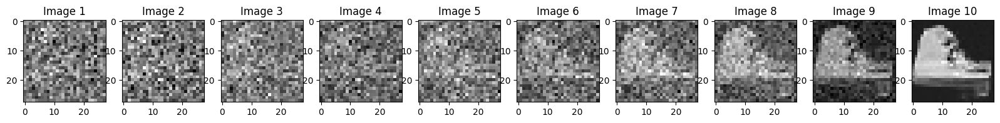

In [162]:
model.eval()
imgs = sample(model, (1, 1, 28, 28))
fig, axs = plt.subplots(1, 10, figsize=(20, 10))
for i in range(10):
    # Plot the image in the corresponding subplot
    axs[i].imshow(imgs[30*(i+1)-1][0][0].squeeze(), cmap="gray")
    axs[i].set_title(f"Image {i+1}")

plt.show()

# Efficient UNET (584129 parameters/30 epochs)

In this block I improve upon the basic UNET structure provided before, I will make changes that reduce the number of parameters and require fewer epochs whilst still providing good samples.
The first change is that I now include a residual connection at the beginning of the encoding in a traditional UNET fashion, and remove the concatenation at the bottom of the U, as this is a concatenation where neither object has been decoded. immediately this reduces the number of parameters to around 800k and produces good results for 30 epochs.

The next change is the addition of a convolution and an attention block in the encoded space, to boost the efficiency of the model, and replacing the decoding step with a MaxPool, which has no parameters and achieves very similar results to a convolution.

With these changes what is left is to fine tune the hyperparameters: number of down blocks (limited by 1 by 1 spatial dimension, can be interpolated on the decoding to maintain size), the time embedding dimension, and the loss function. I have chosen an l1 loss function as this tends to give less noisy results earlier in training than mse.

In [114]:
# Code to make your most efficient setup goes here; present all code from above in one Code block
# run it to show final runtimes and print out the total number of parameters in the mode. 
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        '''
        in_ch refers to the number of channels in the input to the operation and out_ch how many should be in the output
        '''
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            # A convolution with a kernel size of 3 and padding of 1, followed by a transposed convolution with a kernel size of 4, stride of 2 and padding of 1, fewer parameters and similar performance to the convolution.
            self.conv1 = nn.Sequential(nn.Conv2d(2*in_ch, 2*in_ch, 3, padding=1, groups = 2*in_ch), nn.Conv2d(2*in_ch, out_ch, 1))
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1, groups=in_ch)
            # Here I step down with a maxpooling operation, which does not require any parameters and follows the UNET architecture.
            self.transform = nn.MaxPool2d(2,stride=2) 
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

        
    def forward(self, x, t):
        '''
        Define the forward pass making use of the components above. 
        Time t should get mapped through the time_mlp layer + a relu
        The input x should get mapped through a convolutional layer with relu / batchnorm
        The time embedding should get added the output from the input convolution 
        A second convolution should be applied and finally passed through the self.transform. 
        '''
        time_emb = self.time_mlp(t)
        time_emb = self.relu(time_emb)
        x = self.conv1(x)
        x = self.bnorm1(x)
        x = self.relu(x)
        
        x = x + time_emb.unsqueeze(-1).unsqueeze(-1)
        x = self.conv2(x)
        x = self.bnorm2(x)
        x = self.relu(x)
        
        x = self.transform(x)
        return x

#Linear attention module, standard architecture
class LinearAttention(nn.Module):
    def __init__(self, dim, heads=4, dim_head=32):
        super().__init__()
        self.scale = dim_head**-0.5
        self.heads = heads
        hidden_dim = dim_head * heads
        self.to_qkv = nn.Conv2d(dim, hidden_dim * 3, 1, bias=False)

        self.to_out = nn.Sequential(nn.Conv2d(hidden_dim, dim, 1),
                                    nn.GroupNorm(1, dim))

    def forward(self, x):
        b, c, h, w = x.shape
        qkv = self.to_qkv(x).chunk(3, dim=1)
        q, k, v = map(
            lambda t: rearrange(t, "b (h c) x y -> b h c (x y)", h=self.heads), qkv
        )

        q = q.softmax(dim=-2)
        k = k.softmax(dim=-1)

        q = q * self.scale
        context = torch.einsum("b h d n, b h e n -> b h d e", k, v)

        out = torch.einsum("b h d e, b h d n -> b h e n", context, q)
        out = rearrange(out, "b h c (x y) -> b (h c) x y", h=self.heads, x=h, y=w)
        return self.to_out(out)
    
class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 1
        down_channels = (32, 64,128) # These are the channels that we want to obtain in the downsampling stage
        up_channels = (64, 64, 32) # These are the channels that we want to obtain in the upsampling stage

        out_dim = 1
        time_emb_dim = 64

        # Time embedding consists of a Sinusoidal embedding, a linear map that maintains the dimensions and a rectified linear unit activation. 
        self.time_emb = nn.Sequential(SinusoidalPositionEmbeddings(time_emb_dim),
                                        nn.Linear(time_emb_dim, time_emb_dim),
                                        nn.ReLU())
        
        # Initial projection consisting of a map from image_channels to down_channels[0] with a filter size of e.g. 3 and padding of 1. 
        self.init_proj = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)
        # Downsample: use the Blocks given above to define down_channels number of downsampling operations. These operations should cha
        self.down = nn.ModuleList([Block(down_channels[i], down_channels[i+1], time_emb_dim, up = False) for i in range(len(down_channels)-1)])
        self.middle = nn.Sequential(nn.Conv2d(down_channels[-1], down_channels[-1], 3, padding=1), nn.BatchNorm2d(down_channels[-1]), nn.ReLU())
        #self.down_attention = nn.ModuleList([LinearAttention(down_channels[i], heads=8, dim_head=down_channels[i]//8) for i in range(len(down_channels)-1)])
        self.mid_attention = LinearAttention(down_channels[-1], heads=16, dim_head=down_channels[-1]//12)
        # attention on up and down is an effective way to improve the model, however this increases train time and parameters so not optimised for this task
        #self.up_attention = nn.ModuleList([LinearAttention(up_channels[i+1], heads=8, dim_head=down_channels[i]//8) for i in range(len(up_channels)-1)])
        # Upsample
        self.up = nn.ModuleList([Block(up_channels[i], up_channels[i+1], time_emb_dim, up=True) for i in range(len(up_channels)-1)])
        
        # Final output: given by a final convolution that maps up_channels[-1] to out_dim with a kernel of size 1. 
        self.final = nn.Conv2d(2*up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        time_emb = self.time_emb(timestep)
        # Initial conv
        x = self.init_proj(x)
        # Unet: iterate through the downsampling operations and the upsampling operations. Do not forget to include the residual connections 
        # between the outputs from the downsample stage and the upsample stage. 

        skip_connections = []

        for block in self.down:
            skip_connections.append(x)
            x = block(x, time_emb)

        x = self.middle(x)
        x = self.mid_attention(x)
        
        for block, skip_connection in zip(self.up, skip_connections[::-1]):
            x = block(x, time_emb)
            # an interpolation step for generalising to different image sizes or further encoding/decoding
            # if x.shape[-1] != skip_connection.shape[-1]:
            #     x = F.interpolate(x, size=skip_connection.shape[2:], mode='bilinear', align_corners=False)
            x = torch.cat((x, skip_connection), dim=1)
        x = self.final(x)
        return x
    
model = SimpleUnet()   
print(sum(p.numel() for p in model.parameters() if p.requires_grad))
    

584129


# Optimised UNET train loop
30 epochs
(This loop was run for 20 epochs, the model was saved and continued for another 10 to ensure gpu access. The train samples discussed in the interpretation are as described/ similar to that of the first training sample above)

The model has 584129 parameters


  0%|          | 0/468 [00:00<?, ?it/s]

100%|██████████| 468/468 [00:34<00:00, 13.56it/s]


Epoch 1 loss: 0.17855764900007817
Test loss: 0.17852123310932747


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 109.13it/s]


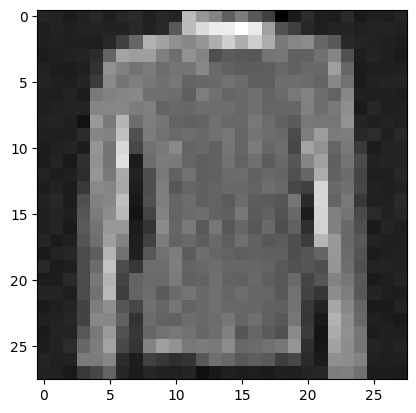

100%|██████████| 468/468 [00:35<00:00, 13.05it/s]


Epoch 2 loss: 0.1783133764615935
Test loss: 0.17861514481214377


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 106.11it/s]


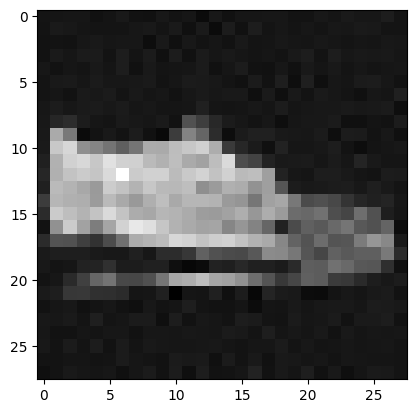

100%|██████████| 468/468 [00:36<00:00, 12.65it/s]


Epoch 3 loss: 0.17704317470391592
Test loss: 0.17574173976213503


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 104.93it/s]


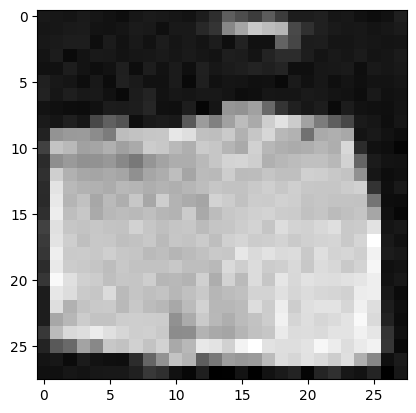

100%|██████████| 468/468 [00:34<00:00, 13.69it/s]


Epoch 4 loss: 0.17751740345842817
Test loss: 0.17580977827310562


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 115.89it/s]


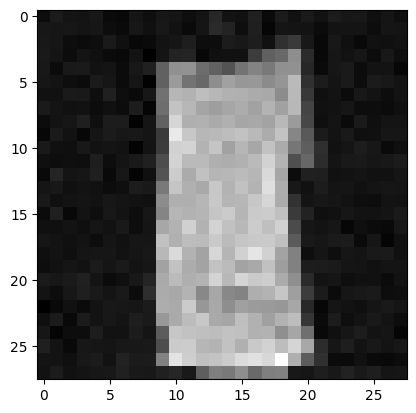

100%|██████████| 468/468 [00:34<00:00, 13.53it/s]


Epoch 5 loss: 0.1767869202945477
Test loss: 0.17751448028362715


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 109.55it/s]


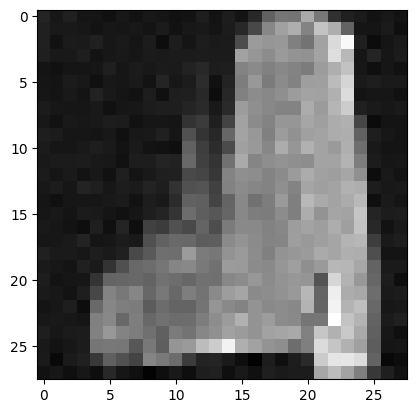

100%|██████████| 468/468 [00:34<00:00, 13.54it/s]


Epoch 6 loss: 0.17657388762658477
Test loss: 0.17340408112758246


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 107.72it/s]


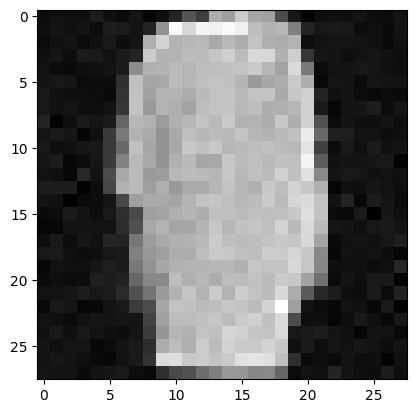

100%|██████████| 468/468 [00:34<00:00, 13.47it/s]


Epoch 7 loss: 0.1760737899467986
Test loss: 0.17693070456003532


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 110.84it/s]


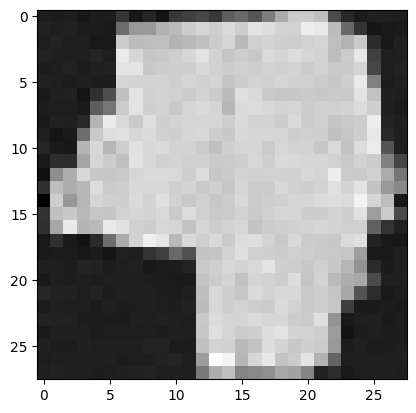

100%|██████████| 468/468 [00:34<00:00, 13.57it/s]


Epoch 8 loss: 0.17502623277469578
Test loss: 0.17691606837205398


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 102.23it/s]


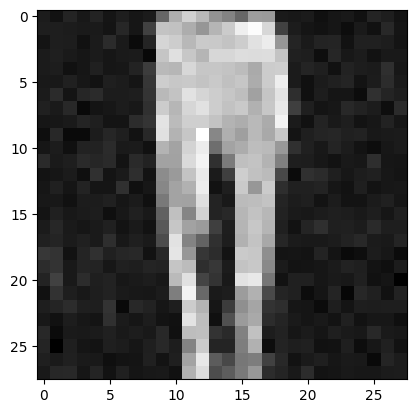

100%|██████████| 468/468 [00:35<00:00, 13.20it/s]


Epoch 9 loss: 0.17536384153824586
Test loss: 0.17610705013458544


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 110.12it/s]


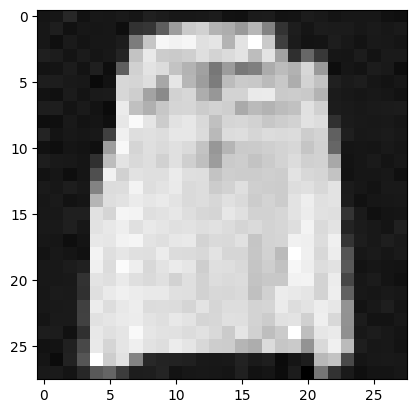

100%|██████████| 468/468 [00:34<00:00, 13.59it/s]


Epoch 10 loss: 0.17459040851547167
Test loss: 0.17325164014712358


sampling loop time step: 100%|██████████| 300/300 [00:02<00:00, 109.73it/s]


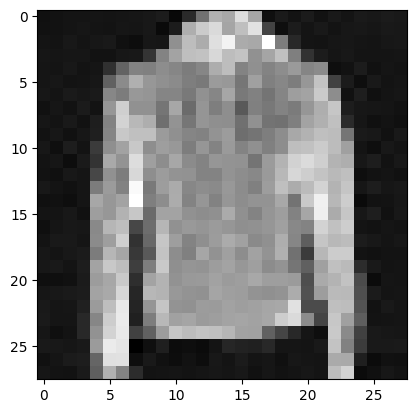

In [118]:
model = SimpleUnet()
model = model.to(device)
model.train()
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model)} parameters')
# Define the optimizer
optimizer = Adam(model.parameters(), lr=0.001)

# Training loop
for epoch in range(10):
    epoch_loss = 0
    for batch in tqdm(dataloader):
        optimizer.zero_grad()
        x_0 = batch["pixel_values"].to(device)
        t = torch.randint(0, T, (BATCH_SIZE,), device=device)
        loss = get_loss(model, x_0, t)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        
    print(f"Epoch {epoch+1} loss: {epoch_loss/len(dataloader)}")
    
    #test loss
    test_loss = 0
    for batch in test_dataloader:
        x_0 = batch["pixel_values"].to(device)
        t = torch.randint(0, T, (BATCH_SIZE,), device=device)
        loss = get_loss(model, x_0, t)
        test_loss += loss.item()
    print(f"Test loss: {test_loss/len(test_dataloader)}")

    # Visualize the results
    imgs = sample(model, (1, 1, 28, 28))
    plt.imshow(imgs[-1][0].squeeze(), cmap="gray")
    plt.show()

# Interpretation of results:

The simple unoptimised UNET had many redundant parameters, as demostrated by the optimised UNET which has fewer parameters and can produce good results in fewer epochs.

To increase efficiency the first change I made was converting the down convolution to a max pooling layer, which uses no parameters. This is an efficient choice because encoding uses many parameters to decrease spatial dimension, and the information lost will be recovered in the residual connection. Another similar change was made to the first convolution in each block, the convolution which increases/decreases the number of channels can also be represented with fewer parameters by first convolving within each channel, followed by a 1 by 1 convolution to alter the number of channels.

To make up for this drop in inefficient parameters I introduced a convolution followed by a multi headed attention block at the most encoded stage of the UNET, this is because the feature space is most rich, and the spatial dimensions are low, making multi head attention most efficient and effective. The specific attention I chose was a linear model, of which I used a standard efficient structure using convolutions. 
When adding attention to a model it gains the ability to place weights on various areas on the input image, which is beneficial when considering shapes and sizes of objects as well as putting less emphasis on the empty space, giving the model some perception as to the image underneath the added noise. In addition to this it is helpful to notice the imprecise nature of upsampling, providing motivation to compute attention to maintain the most relevent spatial features when concatinating with the skip connection. My implementation could be built upon in this way by computing attention on each residual connection with its corresponding feature rich upsample, but this was ommitted in interest of maintaining low parameter count.

These changes give insight to how the model learns, and to the benefits of infusing a UNET structure with multi head attention, which only marginally increases wall time due to the splitting of heads as discussed in question 1. 
By showing the image every 5 epochs we can observe the stages of learning as the loss decreases, in early epochs the model will try to create a solid block shape with minimal noise, showing that it is capable of understanding that extreme pixel values are relevent in the dataset and that it is a cruicial feature. The success rate of returning a noiseless image is generally lower in this phase. It then becomes better at making distinct labels from the dataset, often those most similar to the shapes it made prior.

The model can clearly learn with or without attention, in very similar structure, by encoding the image into a rich feature space and making use of residual connections as to not lose prior information. Since both implemented models are built on this foundation both can produce similar outcomes up to fine tuning the more efficient model.

The requirements for the UNET to be optimised are fewer epochs and fewer parameters, so long as the model still produces 'good' samples, (here I take good to mean identifyable with minimal noticable errors as opposed to indistinguishable from the dataset).

Our train loop results also show convergence in loss, and little to no average difference in test and train loss, hence the models are not overfitting to the dataset, instead reducing loss by creatiing certain features or patterns.

sampling loop time step:   0%|          | 0/300 [00:00<?, ?it/s]

sampling loop time step: 100%|██████████| 300/300 [00:09<00:00, 31.98it/s]


(200, 1, 28, 28)


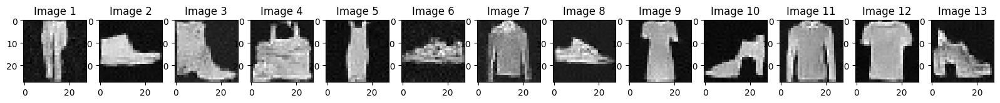

In [133]:
# Here goes the code for visualising during training and add a discussion above. 
# Code for the plotting of samples goes here
torch.manual_seed(4455)
imgs = sample(model, (200, 1, 28, 28))
print(imgs[-1].shape)
fig, axs = plt.subplots(1, 13, figsize=(20, 10))
idx = [7,10,16,103,39,174,194,138,184,81,153,147,192,200]
for i in range(13):
    axs[i].imshow(imgs[-1][idx[i]-1][0].squeeze(), cmap="gray")
    axs[i].set_title(f"Image {i+1}")

plt.show()

### Part 3. On DeepDream [5 points]

In this task we will implement a DeepDream model in order to generate ‘dreams’: images enhanced by the neural network. 

Here we will work with a pre-trained model (Inception-V3). The idea is as follows: we will load some image (you can later on choose to load your own image if you want). We will load the Inception-V3 model. We will pass it an input and obtain the activation outputs from a certain layer. We will 'ask' the neural network to maximise the values of the activation, i.e. enhance the image with what those layer activations 'like' to see. For this we will implement a gradient ascent method in order to maximise a norm of the activations over that input. This will change our input into a `dream'. 

1. [1 point] Write a piece of code that will load the Inception-V3 model and allow you to get access to the intermediate activations. 

2. [2 points] Implement the deepdream optimisation loop. We will use gradient ascent to optimise for the norm of the activation. Implement a function that performs this gradient ascent. This function will take as input the number of iterations to perform, the learning rate, and the start image (i.e. the image which the model will enhance). Define in the function a for loop over the number of iterations, obtain the model output, get the output of the hook (hint: use something like `outputs[-1]`), compute the loss which will be L2 norm of this output (i.e. the L2 norm of the activations from your chosen layer), compute the gradients of this L2 norm loss, scale the gradients by their absolute average (hint: scale using `torch.abs(g).mean()`) and define a gradient ascent step over the image. Do not forget to zero out gradients where needed. 

3. [1 point] Implement code to load an image (e.g. https://github.com/pytorch/hub/raw/master/images/dog.jpg) and display the output from your optimisation loop (using e.g. numpy). Present the generated images for different choices of layer activations and different number of optimisation steps. Discuss your results. What is the impact of using different layers? What is the impact of the number of optimisation steps? [0.5 point will be given for the implementation and 1.5 point for a very good discussion]

4. [1 point] In our previous setting we allowed for optimising for a single layer's activation. Change the method such that it will allow to compute the loss (L2 norm) of multiple layers' outputs. Present three different setups using different numbers & combinations of layers and discuss your results in max. 3 lines. 

# Import the model and store the 21 intermediate activations.

In [174]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
import torch.nn as nn
from PIL import Image
from torchvision import transforms
device = 'cpu'
# Load the pre-trained Inception-V3 model
model = models.inception_v3(pretrained=True)

# Handy list of module names to use when calling the function below
module_names = []
for name, module in model.named_children():
    module_names.append(name)
del module_names[15]
module_names


/Users/viba/machine_learning/project_2/.venv/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/viba/machine_learning/project_2/.venv/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


['Conv2d_1a_3x3',
 'Conv2d_2a_3x3',
 'Conv2d_2b_3x3',
 'maxpool1',
 'Conv2d_3b_1x1',
 'Conv2d_4a_3x3',
 'maxpool2',
 'Mixed_5b',
 'Mixed_5c',
 'Mixed_5d',
 'Mixed_6a',
 'Mixed_6b',
 'Mixed_6c',
 'Mixed_6d',
 'Mixed_6e',
 'Mixed_7a',
 'Mixed_7b',
 'Mixed_7c',
 'avgpool',
 'dropout',
 'fc']

# Import image

input batch torch.Size([1, 3, 299, 299])


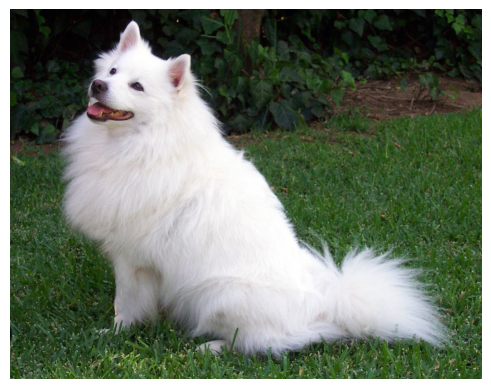

In [175]:
IMAGE_PATH = '/Users/viba/machine_learning/project_2/dog.jpg'
image = Image.open(IMAGE_PATH)
IMG_SIZE = 299
#define preprocess
initial_preprocess = transforms.Compose([
    transforms.Resize(IMG_SIZE),
    transforms.CenterCrop(IMG_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

input_tensor = initial_preprocess(image)
input_batch = input_tensor.unsqueeze(0) # create a mini-batch as expected by the model

# set requires_grad to True for calculating the gradients with respect to the input
input_batch.requires_grad = True
print(f"input batch {input_batch.shape}")
#Display the image
plt.imshow(image)
plt.axis('off')
plt.show()

# Deep dream optimisation loop

This function can take a single layer, or a weighted multiple layer input to perform gradient ascent with L2 loss across multiple activations at once.

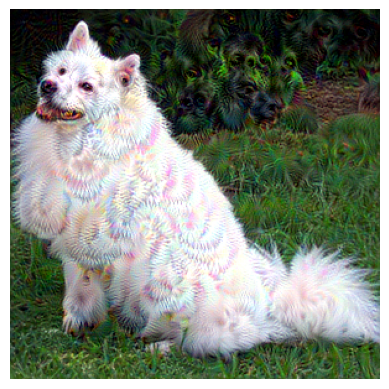

In [176]:
# Define the deep dream optimization function

def deepdream_optimization(image, model, iterations, lr, layers, weights):
    """
    a function that performs the deep dream optimization by maximizing the activations of the chosen layers
    parameters:
    image: the input image, (1, 3, H, W)
    model: the pre-trained model
    iterations: the number of optimization steps
    lr: the learning rate
    layers: the list of layers whose activations we want to maximize, list of strings
    weights: the weights to assign to the activations of each layer, (len(layers),)
    returns:
    the optimized image, (1, 3, H, W)
    """

    outputs = [] # a list to store the activations of the chosen layers
    if layers == []: # if no layers are chosen
        return image
    hooks = [] # a list to store the hooks to remove the hooks later
    for layer in layers:
        hook = dict([*model.named_modules()])[layer].register_forward_hook(lambda module, input, output: outputs.append(output))
        hooks.append(hook)
    # Set the model to evaluation mode
    model.eval()
    # Perform gradient ascent
    for i in range(iterations):
        if image.grad is not None:
            image.grad.zero_()
        
        # Forward pass through the model to obtain the activations of the chosen layers
        outputs.clear()
        model(image)

        # Compute the loss as the L2 norm of the weighted activations
        loss = sum(weights[j]*torch.norm(output) for j, output in enumerate(outputs))#/len(outputs)
        
        # Backward pass to compute gradients
        loss.backward()

        g = image.grad
        g = g/torch.abs(g).mean()
        
        # Update the image using gradient ascent
        with torch.no_grad():
            image += g*lr
        # zero the gradients
        image.grad.zero_()
    # Optional line to see the dominating layers and apply weights accordingly
    #print([torch.norm(outputs[j]) for j in range(len(outputs))])
    # Remove the hooks
    for hook in hooks:
        hook.remove()
    image = image.detach()
    return image


# Perform deep dream optimization
dream_image = deepdream_optimization(input_batch, model, layers=[module_names[11]],iterations=100, lr=0.01, weights=(1,))

# Convert the dream image back to a numpy array
def deconvert_image(dream_image):
    mean, std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
    dream_image_np = dream_image.squeeze().detach().cpu().numpy().transpose((1, 2, 0))
    dream_image_np *= std
    dream_image_np += mean
    dream_image_np = np.clip(dream_image_np, 0, 1)
    return dream_image_np
dream_image_np = deconvert_image(dream_image)
plt.imshow(dream_image_np)
plt.axis('off')
plt.show()

100%|██████████| 21/21 [03:16<00:00,  9.34s/it]


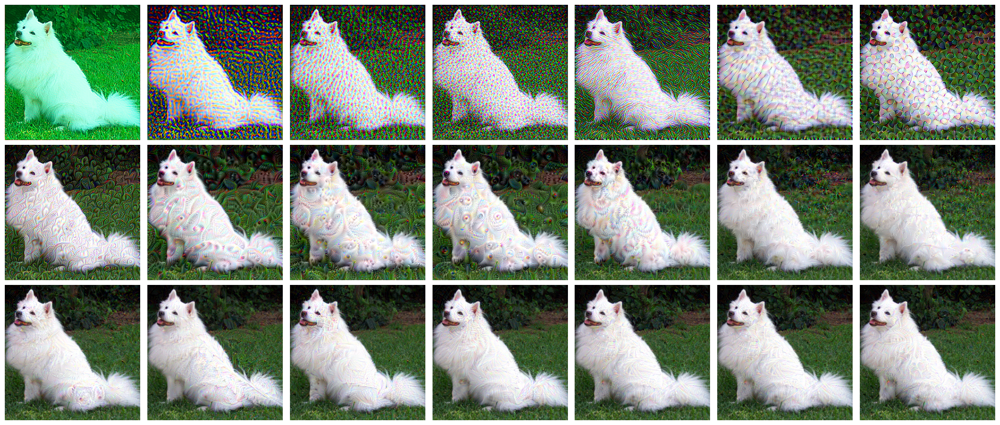

In [7]:
from tqdm import tqdm
rows, cols = 3, 7
fig, axes = plt.subplots(rows, cols, figsize=(cols*3, rows*3))
device = 'cpu'
model.to(device)
for i, module_name in enumerate(tqdm(module_names)):
    input_tensor = initial_preprocess(image)
    input_batch = input_tensor.unsqueeze(0)
    input_batch.requires_grad_(True)
    dream_image = deepdream_optimization(input_batch, model, layers=[module_name],iterations=100, lr=0.01, weights=(1,))

    dream_image_np = deconvert_image(dream_image)

    row = i // cols
    col = i % cols

    # Display image
    ax = axes[row, col]
    ax.imshow(dream_image_np)
    ax.axis('off')
plt.tight_layout()
plt.show()


Each layer in inceptionv3 1 to 21: layers 8 to 18 inclusive are the "mixed" layers

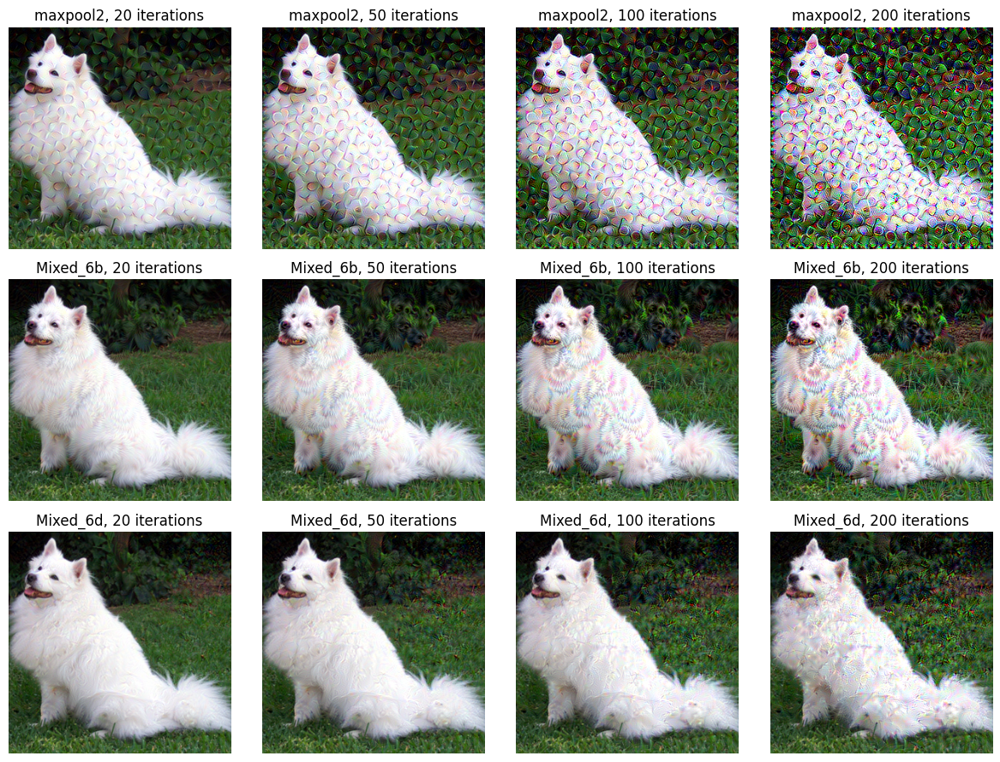

In [181]:
rows, cols = 3, 4
fig, axes = plt.subplots(rows, cols, figsize=(cols*3, rows*3))
iterations = [20, 50, 100, 200]
for j, module_name in enumerate([module_names[6], module_names[11],module_names[13]]):
    for i, iter in enumerate(iterations):
        input_tensor = initial_preprocess(image)
        input_batch = input_tensor.unsqueeze(0)
        input_batch.requires_grad_(True)
        dream_image = deepdream_optimization(input_batch, model, layers=[module_name],iterations=iter, lr=0.01, weights=(1,))
        dream_image_np = deconvert_image(dream_image)

        # Display image
        ax = axes[j, i]
        ax.imshow(dream_image_np)
        ax.set_title(f"{module_name}, {iter} iterations")
        ax.axis('off')
plt.tight_layout()
plt.show()

# Discussion

Each layer picks up on different features in the underlying image, later layers seem to pick up more complex patterns that build on previous information, for example layers 1 to 4 pick up simple colour and contrast information at different granularities, layers 5 to 7 build upon this and can find brush-stroke like patterns and loops. The mixed layers, 8 to 18 build further on this and find spirals, spikes and begin to find features in relation to other features such as dots with spirals and trails. The final layers look much more similar to the original image because the layers have become complex enough to identify most features in the image, it also takes more iterations to notice the effect of gradient ascent.

Some notable layers include 11, where systems of dots and trails become more prominent, potentially the building blocks to eyes and face like features, 13, where there is a noticable difference in the spikey dog fur and grass, and 14 where a connected mesh begins to appear over the dog.

A larger number of steps will highlight the features even more so, because each iteration will find the same features it found before and enhance them in the gradient ascent step.

# Rescaling the image: Octaves

The size of the features scale with the image, here I have created a loop that will successively apply multiple weighted layers to different sizes of images for a desired affect.

torch.Size([1, 3, 300, 300])
Octave 0 Image shape: torch.Size([1, 3, 300, 300])


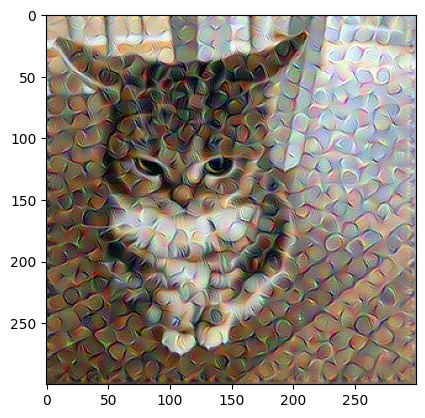

Octave 1 Image shape: torch.Size([1, 3, 177, 177])


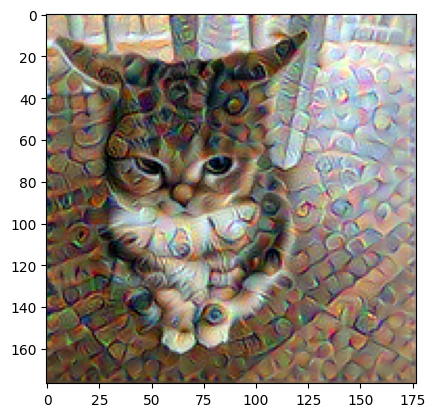

Octave 2 Image shape: torch.Size([1, 3, 230, 230])


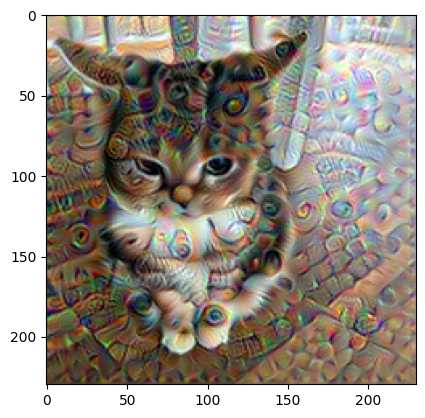

Octave 3 Image shape: torch.Size([1, 3, 300, 300])


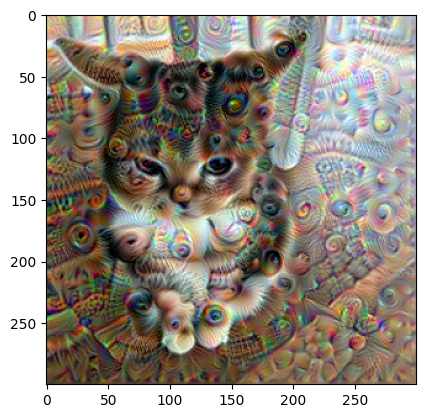

Octave 4 Image shape: torch.Size([1, 3, 390, 390])


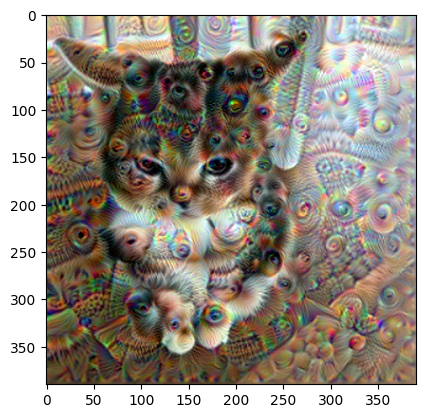

Octave 5 Image shape: torch.Size([1, 3, 400, 400])


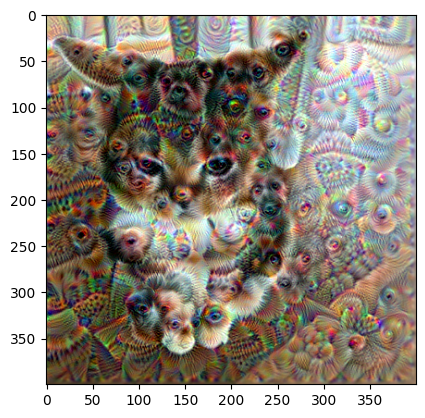

Octave 6 Image shape: torch.Size([1, 3, 400, 400])


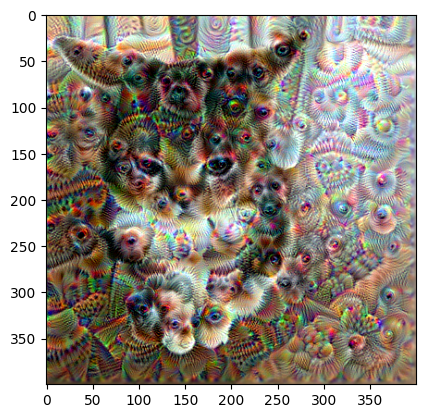

Octave 7 Image shape: torch.Size([1, 3, 400, 400])


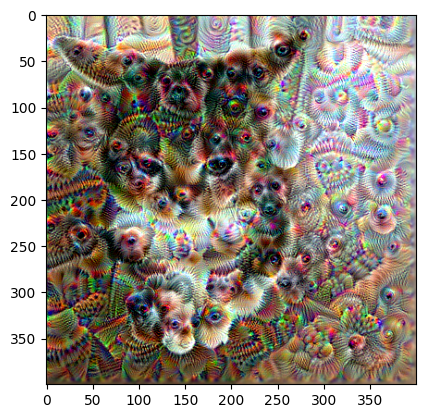

In [345]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
import torch.nn as nn
import urllib
from PIL import Image
from torchvision import transforms
import torch.nn.functional as F
device = 'mps'
IMG_SIZE = 300
octave_scale = 1.3
num_sizes = 8
mean, std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
preprocess = transforms.Compose([
    transforms.Resize(IMG_SIZE),
    transforms.CenterCrop(IMG_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
IMAGE_PATH = "/Users/viba/machine_learning/project_2/original-905E84BC-E7C3-48D4-8482-FB7878E3B31F.jpeg"
image = Image.open(IMAGE_PATH)
image = preprocess(image)
image = image.unsqueeze(0)
#image = image.to(device)
image.requires_grad = True
print(image.shape)

# Handy dictionaries with pre defined layers for each size

layers_for_size_a = {
    0: [4],
    1: [9],
    2: [9],
    3: [6,11],
    4: [9],
    5: [6,9],
    6: [],
    7: [],
}
#animal features
layers_for_size_b = {
    0: [],
    1: [6,1],
    2: [10,9],
    3: [10,10],
    4: [11,4],
    5: [10,12],
    6: [10,12],
    7: [10,12],
}
layers_for_size_c = {
    0: [],
    1: [6,6],
    2: [10,12],
    3: [10,12],
    4: [11,4],
    5: [10,12],
    6: [10,12],
    7: [10,12],
}
layers_for_size_d = {
    0: [],
    1: [6,6],
    2: [10,9],
    3: [10,10],
    4: [4,11],
    5: [10,11],
    6: [11,11],
    7: [10,10],
}

layers_for_size_e = {
    0: [],
    1: [6,6],
    2: [9,9],
    3: [10,10],
    4: [11,11],
    5: [11,12],
    6: [12,12],
    7: [13,13],
}
iters = [25, 50, 50, 50, 50, 100,50]

layers_for_size_f = {
    0: [],
    1: [6,5],
    2: [12,12,10],
    3: [12,11,10],
    4: [12,10,10],
    5: [9,10,12],
    6: [12,12,4],
    7: [11,11,12],
}
layers_for_size_g = {
    0: [6,6],
    1: [6,10],
    2: [9,9],
    3: [11,10],
    4: [11,11],
    5: [11,12],
    6: [12,10],
    7: [10,12],
}


iters = [45, 25, 50,25, 100, 100,100]

for s in range(num_sizes):
    print(f"Octave {s} Image shape: {image.shape}")
    image.to(device)
    dream_image = deepdream_optimization(image, model, layers=[module_names[i] for i in layers_for_size[s]], iterations=iters[s-1], lr=0.005, weights = (0.5,0.5))
    dream_image = deconvert_image(dream_image)

    plt.imshow(dream_image)
    plt.show()

    image = transforms.ToPILImage()(dream_image)
    new_size = min(int(IMG_SIZE * (octave_scale ** -(2-s))),400)
    image = image.resize((new_size, new_size))
    image = transforms.ToTensor()(image)
    image = transforms.Normalize(mean=mean, std=std)(image)
    image = image.unsqueeze(0)
    image.requires_grad = True


    

Performing multiple layer optimisation over various sizes sequentially enables us to create more advanced and diverse deep-dream images like the one above and the samples below. By beginning with lower layers like 6 and iterating many times over layers that can pick up facial features from the features in 6 various animal faces can be found making up the underlying image! Not only this but incorperating lower layers like 4 and 6 we can introduce new art styles to make the image even more creative.

# Some more samples:

torch.Size([1, 3, 300, 300])
Octave 0 Image shape: torch.Size([1, 3, 300, 300])


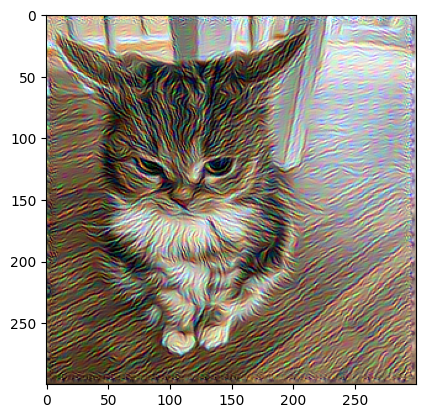

Octave 1 Image shape: torch.Size([1, 3, 177, 177])


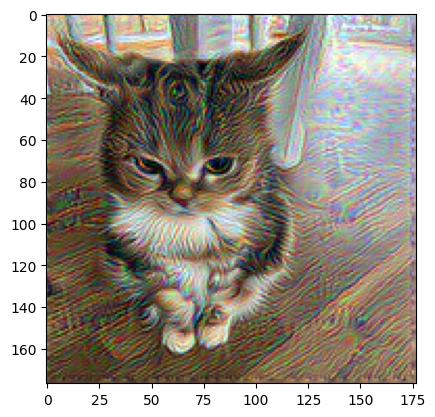

Octave 2 Image shape: torch.Size([1, 3, 230, 230])


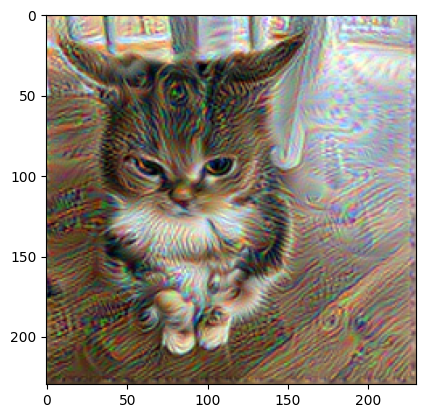

Octave 3 Image shape: torch.Size([1, 3, 300, 300])


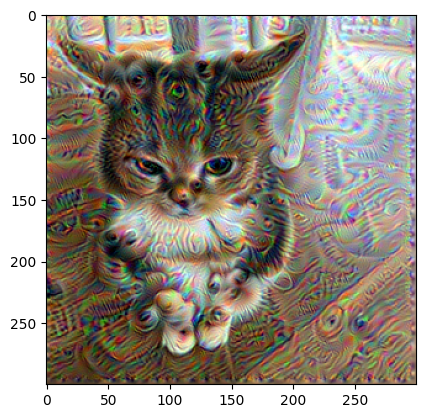

Octave 4 Image shape: torch.Size([1, 3, 390, 390])


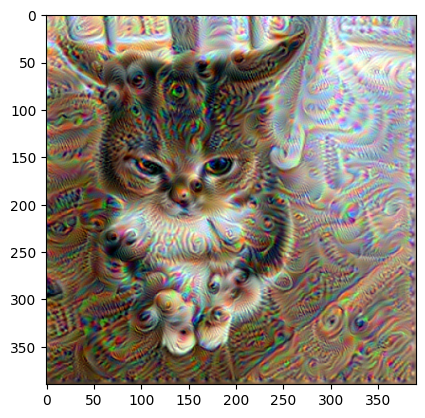

Octave 5 Image shape: torch.Size([1, 3, 400, 400])


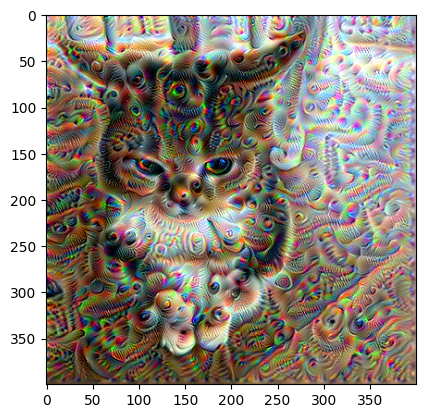

Octave 6 Image shape: torch.Size([1, 3, 400, 400])


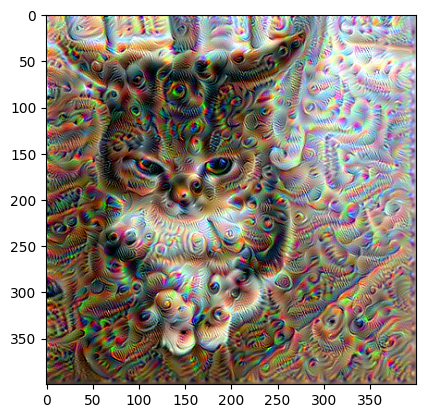

Octave 7 Image shape: torch.Size([1, 3, 400, 400])


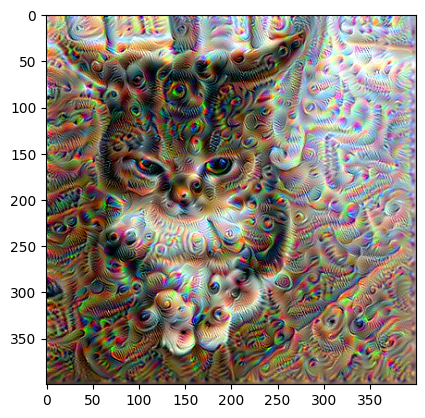

In [185]:
IMG_SIZE = 300
octave_scale = 1.3
num_sizes = 8
mean, std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
preprocess = transforms.Compose([
    transforms.Resize(IMG_SIZE),
    transforms.CenterCrop(IMG_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
IMAGE_PATH = "/Users/viba/machine_learning/project_2/original-905E84BC-E7C3-48D4-8482-FB7878E3B31F.jpeg"
image = Image.open(IMAGE_PATH)
image = preprocess(image)
image = image.unsqueeze(0)
image.requires_grad = True
print(image.shape)
layers_for_size_a = {
    0: [4],
    1: [9],
    2: [9],
    3: [6,11],
    4: [9],
    5: [6,9],
    6: [],
    7: []
}

iters = [45, 25, 50,25, 100, 100,100]

for s in range(num_sizes):
    print(f"Octave {s} Image shape: {image.shape}")
    image.to(device)
    dream_image = deepdream_optimization(image, model, layers=[module_names[i] for i in layers_for_size_a[s]], iterations=iters[s-1], lr=0.005, weights = (0.5,0.5))
    dream_image = deconvert_image(dream_image)

    plt.imshow(dream_image)
    plt.show()

    image = transforms.ToPILImage()(dream_image)
    new_size = min(int(IMG_SIZE * (octave_scale ** -(2-s))),400)
    image = image.resize((new_size, new_size))
    image = transforms.ToTensor()(image)
    image = transforms.Normalize(mean=mean, std=std)(image)
    image = image.unsqueeze(0)
    image.requires_grad = True

torch.Size([1, 3, 300, 300])
Octave 0 Image shape: torch.Size([1, 3, 300, 300])


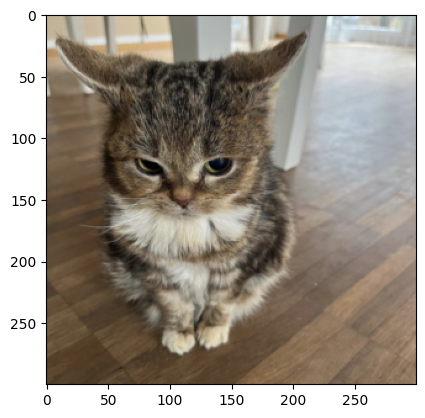

Octave 1 Image shape: torch.Size([1, 3, 177, 177])


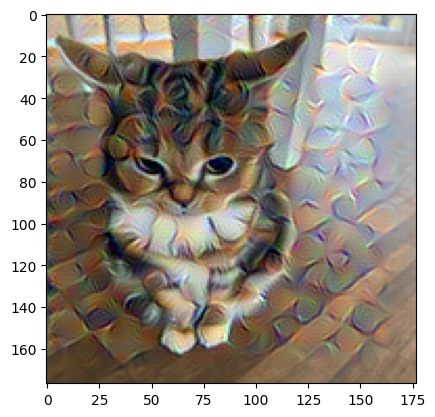

Octave 2 Image shape: torch.Size([1, 3, 230, 230])


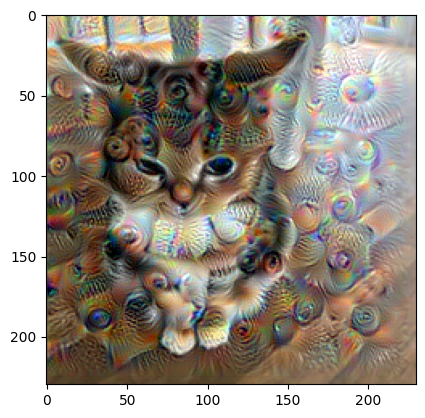

Octave 3 Image shape: torch.Size([1, 3, 300, 300])


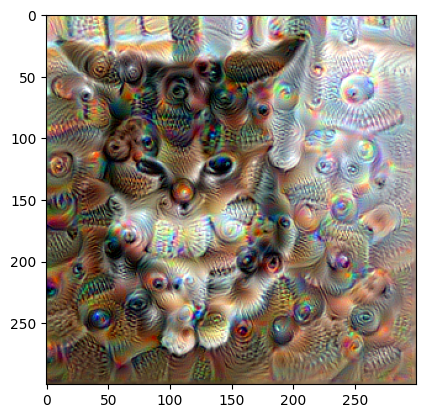

Octave 4 Image shape: torch.Size([1, 3, 390, 390])


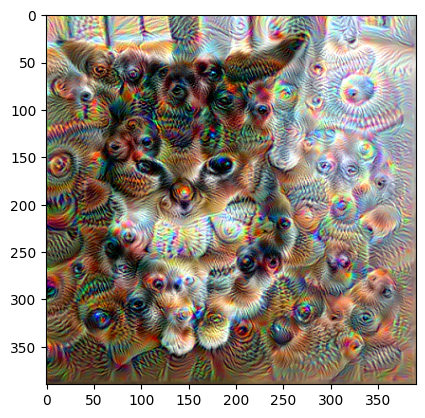

Octave 5 Image shape: torch.Size([1, 3, 400, 400])


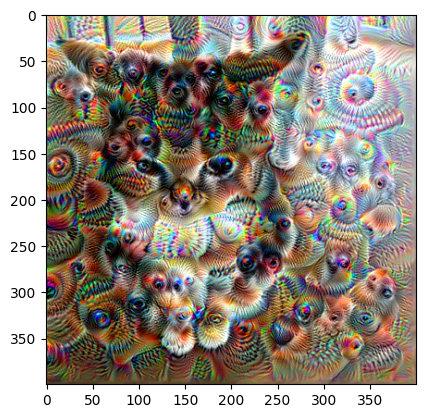

Octave 6 Image shape: torch.Size([1, 3, 400, 400])


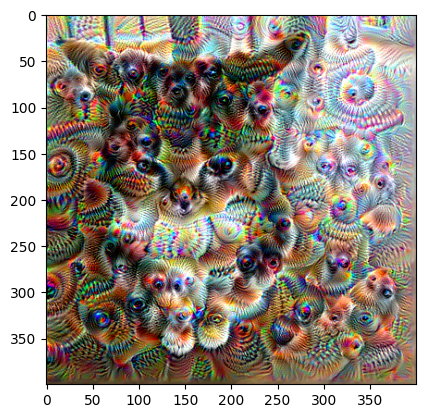

Octave 7 Image shape: torch.Size([1, 3, 400, 400])


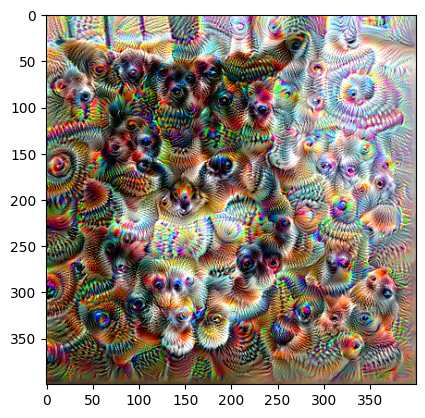

In [188]:
IMG_SIZE = 300
octave_scale = 1.3
num_sizes = 8
mean, std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
preprocess = transforms.Compose([
    transforms.Resize(IMG_SIZE),
    transforms.CenterCrop(IMG_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
IMAGE_PATH = "/Users/viba/machine_learning/project_2/original-905E84BC-E7C3-48D4-8482-FB7878E3B31F.jpeg"
image = Image.open(IMAGE_PATH)
image = preprocess(image)
image = image.unsqueeze(0)
image.requires_grad = True
print(image.shape)
layers_for_size_b = {
    0: [],
    1: [6,1],
    2: [10,9],
    3: [10,10],
    4: [11,4],
    5: [10,12],
    6: [10,12],
    7: [10,12],
}

iters = [45, 100, 100,100, 100, 100,100]

for s in range(num_sizes):
    print(f"Octave {s} Image shape: {image.shape}")
    image.to(device)
    dream_image = deepdream_optimization(image, model, layers=[module_names[i] for i in layers_for_size_b[s]], iterations=iters[s-1], lr=0.005, weights = (0.5,0.5))
    dream_image = deconvert_image(dream_image)

    plt.imshow(dream_image)
    plt.show()

    image = transforms.ToPILImage()(dream_image)
    new_size = min(int(IMG_SIZE * (octave_scale ** -(2-s))),400)
    image = image.resize((new_size, new_size))
    image = transforms.ToTensor()(image)
    image = transforms.Normalize(mean=mean, std=std)(image)
    image = image.unsqueeze(0)
    image.requires_grad = True

torch.Size([1, 3, 300, 300])
Octave 0 Image shape: torch.Size([1, 3, 300, 300])


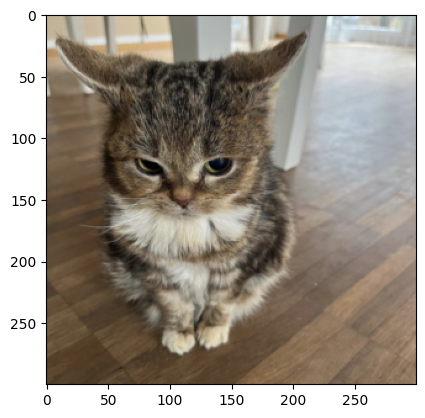

Octave 1 Image shape: torch.Size([1, 3, 177, 177])


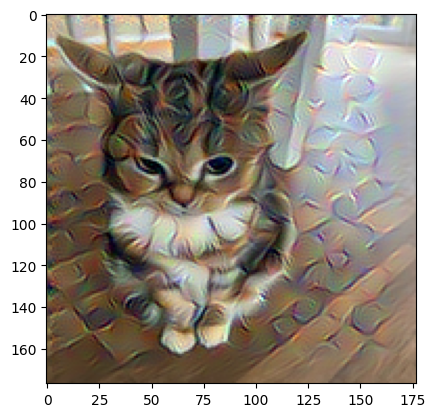

Octave 2 Image shape: torch.Size([1, 3, 230, 230])


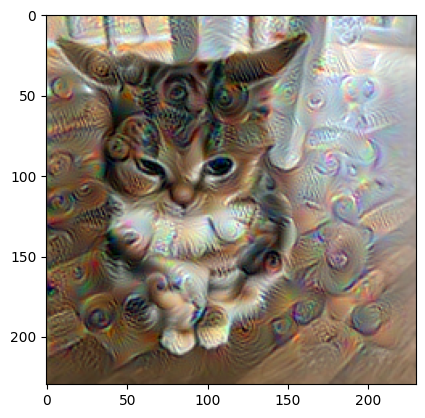

Octave 3 Image shape: torch.Size([1, 3, 300, 300])


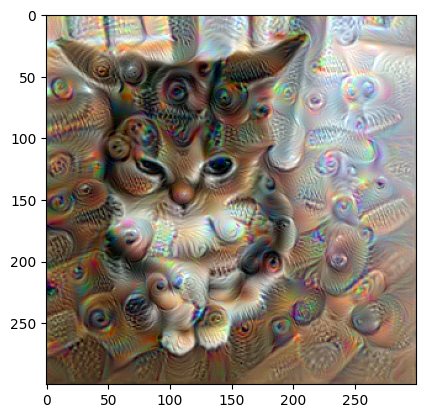

Octave 4 Image shape: torch.Size([1, 3, 390, 390])


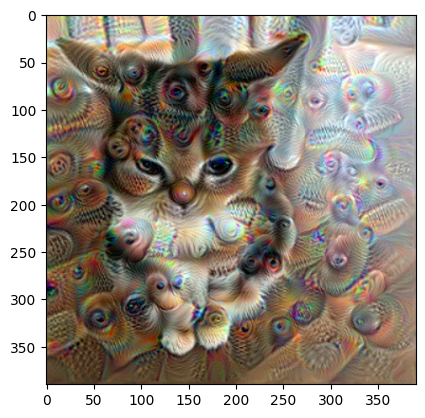

Octave 5 Image shape: torch.Size([1, 3, 500, 500])


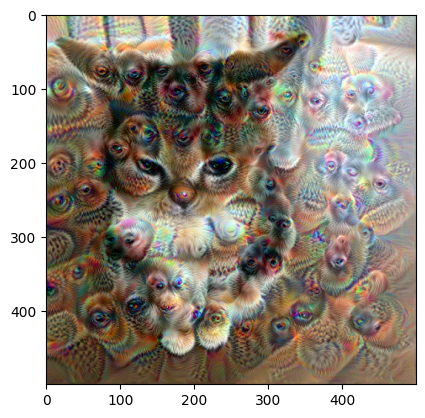

Octave 6 Image shape: torch.Size([1, 3, 500, 500])


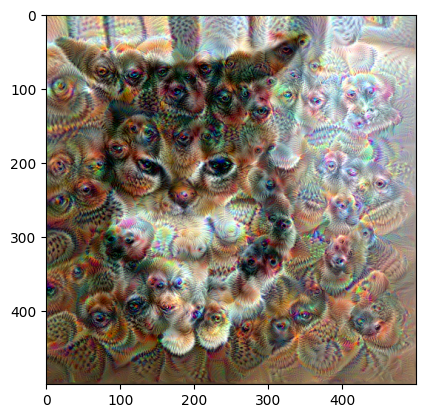

Octave 7 Image shape: torch.Size([1, 3, 500, 500])


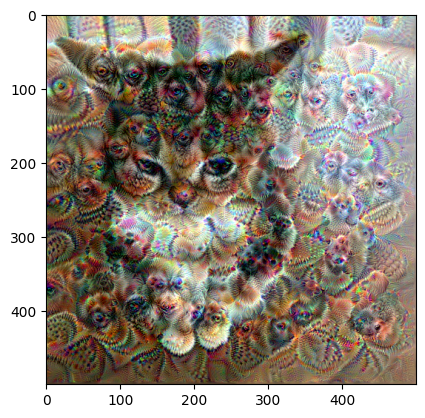

In [192]:
IMG_SIZE = 300
octave_scale = 1.3
num_sizes = 8
mean, std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
preprocess = transforms.Compose([
    transforms.Resize(IMG_SIZE),
    transforms.CenterCrop(IMG_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
IMAGE_PATH = "/Users/viba/machine_learning/project_2/original-905E84BC-E7C3-48D4-8482-FB7878E3B31F.jpeg"
image = Image.open(IMAGE_PATH)
image = preprocess(image)
image = image.unsqueeze(0)
image.requires_grad = True
print(image.shape)

layers_for_size_c = {
    0: [],
    1: [6,6],
    2: [10,12],
    3: [10,12],
    4: [11,4],
    5: [10,12],
    6: [10,12],
    7: [10,12],
}
layers_for_size_d = {
    0: [],
    1: [6,6],
    2: [10,9],
    3: [10,10],
    4: [4,11],
    5: [10,11],
    6: [11,11],
    7: [10,10],
}

layers_for_size_e = {
    0: [],
    1: [4,6],
    2: [9,10],
    3: [10,10],
    4: [11,11],
    5: [11,11],
    6: [12,12],
    7: [13,13],
}

iters = [45, 50, 50,25, 100, 100,100]

for s in range(num_sizes):
    print(f"Octave {s} Image shape: {image.shape}")
    image.to(device)
    dream_image = deepdream_optimization(image, model, layers=[module_names[i] for i in layers_for_size_e[s]], iterations=iters[s-1], lr=0.005, weights = (0.5,0.5))
    dream_image = deconvert_image(dream_image)

    plt.imshow(dream_image)
    plt.show()

    image = transforms.ToPILImage()(dream_image)
    new_size = min(int(IMG_SIZE * (octave_scale ** -(2-s))),500)
    image = image.resize((new_size, new_size))
    image = transforms.ToTensor()(image)
    image = transforms.Normalize(mean=mean, std=std)(image)
    image = image.unsqueeze(0)
    image.requires_grad = True

torch.Size([1, 3, 300, 300])
Octave 0 Image shape: torch.Size([1, 3, 300, 300])


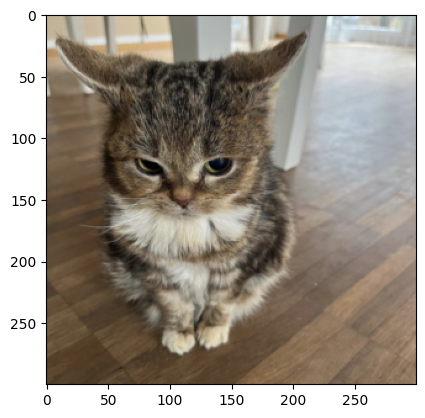

Octave 1 Image shape: torch.Size([1, 3, 177, 177])


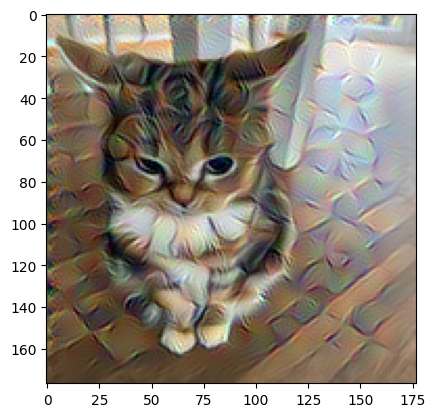

Octave 2 Image shape: torch.Size([1, 3, 230, 230])


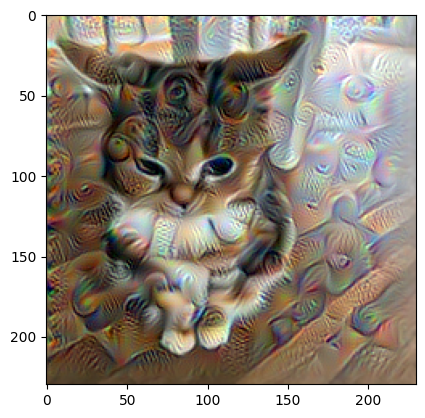

Octave 3 Image shape: torch.Size([1, 3, 300, 300])


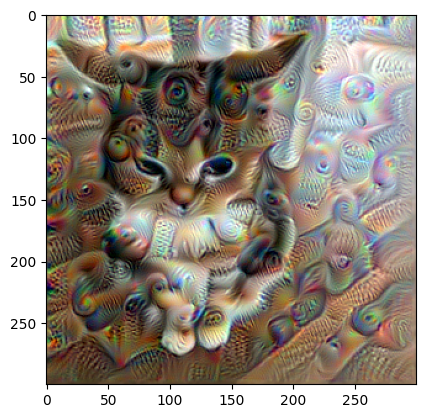

Octave 4 Image shape: torch.Size([1, 3, 390, 390])


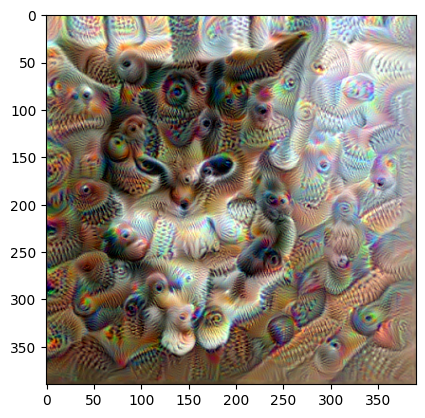

Octave 5 Image shape: torch.Size([1, 3, 507, 507])


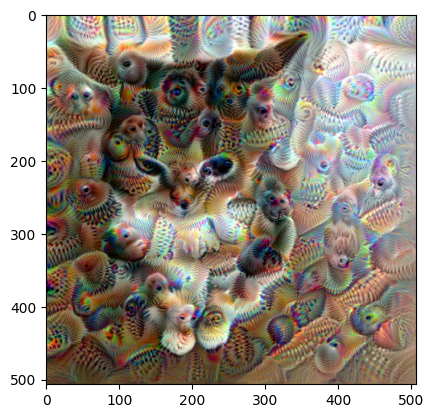

Octave 6 Image shape: torch.Size([1, 3, 600, 600])


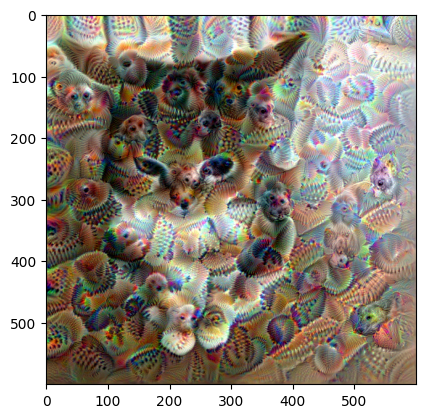

Octave 7 Image shape: torch.Size([1, 3, 600, 600])


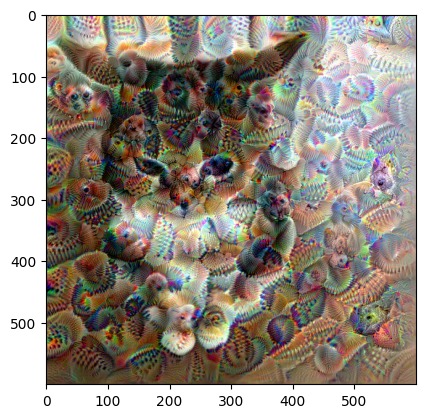

In [193]:
IMG_SIZE = 300
octave_scale = 1.3
num_sizes = 8
mean, std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
preprocess = transforms.Compose([
    transforms.Resize(IMG_SIZE),
    transforms.CenterCrop(IMG_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
IMAGE_PATH = "/Users/viba/machine_learning/project_2/original-905E84BC-E7C3-48D4-8482-FB7878E3B31F.jpeg"
image = Image.open(IMAGE_PATH)
image = preprocess(image)
image = image.unsqueeze(0)
#image = image.to(device)
image.requires_grad = True
print(image.shape)
layers_for_size_b = {
    0: [],
    1: [4,5,6],
    2: [7,8,9],
    3: [8,9,10],
    4: [10,11,12],
    5: [11,12,13],
    6: [12,13,14],
    7: [14,15,16],
}

iters = [45, 65, 65,65, 65, 95,95]

for s in range(num_sizes):
    print(f"Octave {s} Image shape: {image.shape}")
    image.to(device)
    dream_image = deepdream_optimization(image, model, layers=[module_names[i] for i in layers_for_size_b[s]], iterations=iters[s-1], lr=0.005, weights = (0.33,0.33,0.33))
    dream_image = deconvert_image(dream_image)

    plt.imshow(dream_image)
    plt.show()

    image = transforms.ToPILImage()(dream_image)
    new_size = min(int(IMG_SIZE * (octave_scale ** -(2-s))),600)
    image = image.resize((new_size, new_size))
    image = transforms.ToTensor()(image)
    image = transforms.Normalize(mean=mean, std=std)(image)
    image = image.unsqueeze(0)
    image.requires_grad = True